# 1. Setup

In [2]:
import matplotlib.pyplot as plt
import pandas as pd
import cv2
import numpy as np
import os
import torch
import torch.nn as nn
import torch.nn.functional as F

import re

from ultralytics import YOLO

from paddleocr import PaddleOCR
from deep_sort_realtime.deepsort_tracker import DeepSort

/opt/homebrew/Caskroom/miniconda/base/envs/dlenv/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# 2. Prepare dataset

In [3]:
# Find dataset path

data_path = "./Dataset"
print(os.listdir(data_path))

['README.roboflow.txt', 'valid', 'README.dataset.txt', '.DS_Store', 'test', 'data.yaml', 'train', 'testset', 'testset.zip']


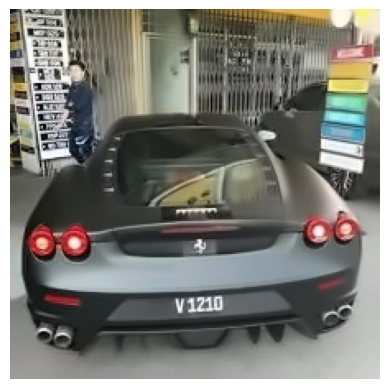

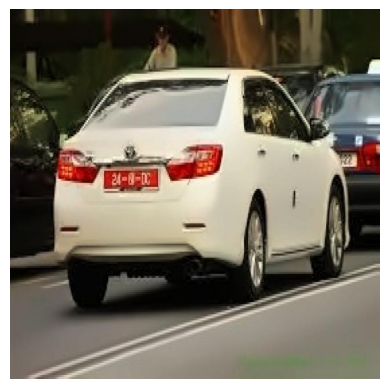

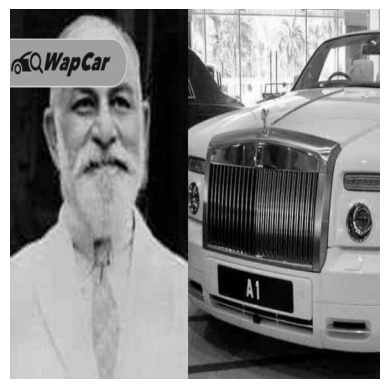

In [4]:
# Show example car plate img

from PIL import Image

test_path = data_path + "/test/images"
img_file = os.listdir(test_path)[:3]

for i in img_file:
    img = Image.open(test_path + '/' + i)
    plt.imshow(img)
    plt.axis("off")
    plt.show()

# 3. Train / Fine Tune YOLO

In [5]:
device  = "cuda" if torch.cuda.is_available() else "cpu"
print(device)

cpu


- ## Model A

In [ ]:
############################
# Coded by Chin Zi Wei
############################

# Model A Training
model = YOLO("yolov8n.pt")

model.train(
    data = f"{data_path}/data.yaml",
    imgsz = 640,
    epochs = 40,
    mosaic = 1.0,
    hsv_h = 0.015, hsv_s = 0.7, hsv_v = 0.4,
    freeze = 10,
    name="modelA"
)

- ## Model B

In [ ]:
############################
# Coded by Ting Jun Jing, Brandon Kong
############################

In [ ]:
# Model B Training (Part 1)
model = YOLO("yolov8n.pt")

model.train(
    data = f"{data_path}/data.yaml",
    imgsz = 640,
    epochs = 15,
    mosaic = 1.0,
    hsv_h = 0.015, hsv_s = 0.7, hsv_v = 0.4,
    freeze = 10,
)

In [ ]:
# Model B Training (Part 2: Training from best.pt of part 1)
model = YOLO("./runs/detect/train2/weights/best.pt")

model.train(
data = f"{data_path}/data.yaml",
    imgsz = 640,
    epochs = 35,
    mosaic = 1.0,
    hsv_h = 0.015, hsv_s = 0.7, hsv_v = 0.4,
    freeze = 0,
    resume = False,
    name="modelB"
)

- ## Model C

In [ ]:
############################
# Coded by Look Zheng Hong
############################

# Model C Training
model = YOLO("yolov8n.pt")

model.train(
    data = f"{data_path}/data.yaml",
    imgsz = 640,
    epochs = 50,
    mosaic = 1.0,
    hsv_h = 0.015, hsv_s = 0.7, hsv_v = 0.4,
    freeze = 0,
    name="modelC"
)

# 4. Plate Detection --> YOLO Detection -> PaddleOCR Recognition

Two types of input -> Video / Images
- For video, DeepSort is apply to assign id to carplate to avoid duplicate ocr prediction

Preprocess -> convert inputs to gray and clahe

Postprocess -> Regex Validation

In [ ]:
############################
# Coded by ALL 
############################

class PlateDetection:
    def __init__(self, model_path="./runs/detect/train2/weights/best.pt"):
        self.model = YOLO(model_path).to(device)
        self.ocr = PaddleOCR(use_textline_orientation=True, lang='en')
        self.tracker = DeepSort(max_age=15, n_init=3, max_iou_distance=0.6)
        
        # Cache OCR results per track_id so don't OCR every frame
        self._ocr_cache = {}

    # postprocess
    def postprocess(self, text):

        #remove space， O, I
        newtext = text.replace(" ","")
        newtext = newtext.replace(".","")
        newtext = newtext.replace("O","Q")
        newtext = newtext.replace("I","1")
        newtext = newtext.replace("l","1")

        #regex valid
        plate_pattern = re.compile(r'^[A-Z]{1,3}\d{1,4}[A-Z]{0,2}$')
        if not plate_pattern.match(newtext):
            newtext = "Invalid : " + newtext

        return newtext

    # ocr prediction function
    def run_ocr(self, crop, use_cache=True):
        # Preprocess crop
        gray = cv2.cvtColor(crop, cv2.COLOR_BGR2GRAY)
        clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
        enhanced = clahe.apply(gray)
        crop = cv2.cvtColor(enhanced, cv2.COLOR_GRAY2BGR)

        results = self.ocr.predict(crop)[0]

        if results and "rec_texts" in results and results["rec_texts"]:
            raw = results["rec_texts"][0]
            conf = results["rec_scores"][0]
        else:
            raw, conf = "", 0.0

        cleaned = self.postprocess(raw)
        return cleaned, conf, crop
    
    # yolo detection per frame function
    def detect_frame(self, frame, conf_thresh=0.3, imgsz=640, run_ocr=True):
        results = self.model.predict(source=frame, conf=conf_thresh, imgsz=imgsz, verbose=False)

        detections = []
        outputs = []

        for r in results:
            if not hasattr(r, "boxes") or r.boxes is None:
                continue
            for box in r.boxes:
                x1, y1, x2, y2 = map(int, box.xyxy[0])
                conf = float(box.conf.item())
                if conf < conf_thresh:
                    continue

                
                # padding if small
                h,w,_ = frame.shape
                box_w, box_h = x2 - x1, y2 - y1
                min_w, min_h = 150, 100
                if box_w < min_w or box_h < min_h:
                    x1_pad = max(0, x1 - int(box_w * 0.2))
                    x2_pad = min(w, x2 + int(box_w * 0.2))
                    y1_pad = max(0, y1 - int(box_h * 0.2))
                    y2_pad = min(h, y2 + int(box_h * 0.2))
                    crop = frame[y1_pad:y2_pad, x1_pad:x2_pad]
                else:
                    crop = r.orig_img[y1:y2, x1:x2]


                text, ocr_conf = ("", 0.0)
                if run_ocr and crop.size > 0:
                    text, ocr_conf, gray_crop = self.run_ocr(crop)
                else:
                    gray_crop = None

                outputs.append({
                    "bbox": (x1, y1, x2, y2),
                    "conf": conf,
                    "plate_text": text,
                    "ocr_conf": ocr_conf,
                    "crop": gray_crop
                })

                detections.append(((x1, y1, x2, y2), conf, "plate"))

        return outputs, detections
    
    # full pipeline --> yolo -> ocr
    def detect_plate(self, img_path):
        img = cv2.imread(img_path)
        outputs, _ = self.detect_frame(img, run_ocr=True)

        for det in outputs:
            x1, y1, x2, y2 = det["bbox"]
            text = det["plate_text"]
            conf = det["ocr_conf"]
            crop = det["crop"]

            cv2.rectangle(img, (x1, y1), (x2, y2), (0,255,0), 2)
            cv2.putText(img, text, (x1, y1-10), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (0,255,0), 2)

            print(f"➡️ Plate: {text} (conf={conf:.2f})")

            # Save result  ← minimal: use basename(img_path) instead of undefined 'filename'
            results_list.append({
                "filename": os.path.basename(img_path),
                "predicted_plate": text,
                "confidence": conf
            })

            plt.figure(figsize=(10,5))

            # Show cropped plate
            plt.subplot(1, 2, 1)   # (rows, cols, index)
            plt.imshow(cv2.cvtColor(crop, cv2.COLOR_BGR2RGB))
            plt.title("Plate Crop")
            plt.axis("off")

            # Show full image
            plt.subplot(1, 2, 2)
            plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
            plt.title("Full Image")
            plt.axis("off")
            plt.show()
        
    # videos preprocess --> assign id, cut into frames
    def detect_video(self, video_path, save_path, show_window=True, skip_rate=3):
        cap = cv2.VideoCapture(video_path)
        in_w  = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
        in_h  = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
        out_w  = 1280
        out_h  = 720
        scale_x = in_w / out_w
        scale_y = in_h / out_h
        scale = max(scale_x, scale_y)

        fourcc = cv2.VideoWriter_fourcc(*'mp4v')
        fps = cap.get(cv2.CAP_PROP_FPS)
        if fps == 0 or fps is None:
            fps = 25
        out = cv2.VideoWriter(save_path, fourcc, float(fps/3), (out_w, out_h))

        frame_count = 0
        ocr_cache = {}
        results_rows = []

        while cap.isOpened():
            ret, frame = cap.read()
            if not ret:
                break

            frame_count += 1

            if frame_count % skip_rate != 0:   # skip frames
                continue

            # detections + SORT
            outputs, detections = self.detect_frame(frame, run_ocr=False)
            print("YOLO detection:", detections)

            tracks = self.tracker.update_tracks(detections, frame=frame)

            for trk in tracks:
                if not trk.is_confirmed():
                    continue

                tid = trk.track_id
                x1, y1, x2, y2 = map(int, trk.to_ltwh())
                crop = frame[y1:y2, x1:x2]

                text, ocr_conf = "", 0.0
                color = (0,255,0)
                
                if crop.size > 0:
                    text, ocr_conf = ocr_cache.get(tid, ("",0.0))

                    if not text or ocr_conf <= 0.8 or text.startswith("Invalid"):
                        temp_text, temp_ocr_conf, _ = self.run_ocr(crop)
                        if not temp_text or temp_ocr_conf <= ocr_conf or temp_text.startswith("Invalid"):
                            color = (0,255,255)
                        else:
                            color = (0,255,0)
                            text, ocr_conf = temp_text, temp_ocr_conf
                            ocr_cache[tid] = (text, ocr_conf)

                        results_rows.append({
                            "frame": frame_count,
                            "track_id": tid,
                            "x1": x1, "y1": y1, "x2": x2, "y2": y2,
                            "plate_text": text,
                            "ocr_conf": ocr_conf
                })

                cv2.rectangle(frame, (x1, y1), (x2, y2), (0,255,0), max(2,int(scale)))
                cv2.putText(frame, f"ID {tid} {text} ({ocr_conf:.2f})",
                            (x1, y1-10), cv2.FONT_HERSHEY_SIMPLEX, max(0.6,0.6*scale), color, max(2,int(scale)))

            frame = cv2.resize(frame, (out_w, out_h))
            if show_window:
                cv2.namedWindow("Detections", cv2.WINDOW_NORMAL)
                cv2.imshow("Detections", frame)
                cv2.resizeWindow("Detections", 1280, 720)
                if cv2.waitKey(1) & 0xFF == ord('q'):
                    break
            out.write(frame)


        cap.release(); out.release()
        if show_window: cv2.destroyAllWindows()
        print(f"✅ Saved video at {save_path}")

        # write CSV
        if results_rows:
            pd.DataFrame(results_rows).to_csv("video_ocr_results.csv", index=False)

        print(f"Processed video saved at {save_path}, CSV saved to video_ocr_results.csv")


# 5. Testing

In [ ]:
############################
# Coded by Brandon Kong
############################
# Detect car plate from video
for video in os.listdir("./video"):
    detector = PlateDetection("./model/modelB/weights/best.pt")
    detector.detect_video(
        "./video/" + video,
        save_path="./outputvideo/output_" + video,
        show_window=True,
        skip_rate=3
    )

Creating model: ('PP-LCNet_x1_0_doc_ori', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models/PP-LCNet_x1_0_doc_ori`.
Creating model: ('UVDoc', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models/UVDoc`.
Creating model: ('PP-LCNet_x1_0_textline_ori', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models/PP-LCNet_x1_0_textline_ori`.
Creating model: ('PP-OCRv5_server_det', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models/PP-OCRv5_server_det`.
Creating model: ('en_PP-OCRv5_mobile_rec', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models

YOLO detection: [((63, 32, 210, 76), 0.7112908959388733, 'plate')]
YOLO detection: [((89, 36, 227, 84), 0.7296769022941589, 'plate')]
YOLO detection: [((115, 44, 256, 98), 0.7584828734397888, 'plate')]
YOLO detection: [((136, 56, 280, 101), 0.7743914127349854, 'plate')]
YOLO detection: [((165, 62, 319, 119), 0.7812893390655518, 'plate')]
YOLO detection: [((189, 76, 343, 127), 0.8100913166999817, 'plate')]
YOLO detection: [((226, 87, 388, 146), 0.8406371474266052, 'plate')]
YOLO detection: [((255, 101, 420, 160), 0.8128215670585632, 'plate')]
YOLO detection: [((285, 110, 455, 170), 0.862205982208252, 'plate')]
YOLO detection: [((314, 122, 490, 182), 0.7821882963180542, 'plate')]
YOLO detection: [((381, 145, 568, 211), 0.7696005702018738, 'plate')]
YOLO detection: [((415, 157, 608, 225), 0.8892931342124939, 'plate')]
YOLO detection: [((470, 179, 674, 247), 0.833101212978363, 'plate')]
YOLO detection: [((511, 196, 721, 267), 0.8253398537635803, 'plate')]
YOLO detection: [((574, 223, 798, 

Creating model: ('PP-LCNet_x1_0_doc_ori', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models/PP-LCNet_x1_0_doc_ori`.
Creating model: ('UVDoc', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models/UVDoc`.
Creating model: ('PP-LCNet_x1_0_textline_ori', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models/PP-LCNet_x1_0_textline_ori`.


YOLO detection: [((1527, 512, 1903, 656), 0.8412452936172485, 'plate')]
YOLO detection: [((1527, 512, 1903, 656), 0.841282069683075, 'plate')]
✅ Saved video at ./outputvideo/output_video_04.mp4
Processed video saved at ./outputvideo/output_video_04.mp4, CSV saved to video_ocr_results.csv


Creating model: ('PP-OCRv5_server_det', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models/PP-OCRv5_server_det`.
Creating model: ('en_PP-OCRv5_mobile_rec', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models/en_PP-OCRv5_mobile_rec`.


YOLO detection: [((662, 450, 780, 495), 0.7600170373916626, 'plate')]
YOLO detection: [((668, 445, 782, 488), 0.7245841026306152, 'plate')]
YOLO detection: [((668, 441, 788, 487), 0.7495167255401611, 'plate')]
YOLO detection: [((673, 444, 791, 488), 0.7346712350845337, 'plate')]
YOLO detection: [((676, 453, 799, 500), 0.6587108373641968, 'plate')]
YOLO detection: [((679, 463, 803, 509), 0.7552776336669922, 'plate')]
YOLO detection: [((682, 459, 809, 507), 0.7335389852523804, 'plate')]
YOLO detection: [((673, 455, 809, 503), 0.7220686674118042, 'plate')]
YOLO detection: [((675, 455, 807, 501), 0.7272666692733765, 'plate')]
YOLO detection: [((678, 452, 803, 498), 0.7001925706863403, 'plate')]
YOLO detection: [((676, 453, 801, 497), 0.6684386134147644, 'plate')]
YOLO detection: [((676, 453, 796, 497), 0.649366021156311, 'plate')]
YOLO detection: [((679, 453, 793, 496), 0.6183095574378967, 'plate')]
YOLO detection: [((675, 453, 794, 495), 0.5893864035606384, 'plate')]
YOLO detection: [((68

Creating model: ('PP-LCNet_x1_0_doc_ori', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models/PP-LCNet_x1_0_doc_ori`.
Creating model: ('UVDoc', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models/UVDoc`.


YOLO detection: [((567, 473, 682, 519), 0.6879977583885193, 'plate')]
YOLO detection: [((566, 474, 676, 519), 0.7157902121543884, 'plate')]
✅ Saved video at ./outputvideo/output_video_02.mp4
Processed video saved at ./outputvideo/output_video_02.mp4, CSV saved to video_ocr_results.csv


Creating model: ('PP-LCNet_x1_0_textline_ori', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models/PP-LCNet_x1_0_textline_ori`.
Creating model: ('PP-OCRv5_server_det', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models/PP-OCRv5_server_det`.
Creating model: ('en_PP-OCRv5_mobile_rec', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models/en_PP-OCRv5_mobile_rec`.


YOLO detection: [((185, 287, 277, 316), 0.8162541389465332, 'plate')]
YOLO detection: [((181, 291, 273, 317), 0.782385528087616, 'plate')]
YOLO detection: [((179, 291, 269, 318), 0.7804970145225525, 'plate')]
YOLO detection: [((173, 292, 267, 320), 0.7693989872932434, 'plate')]
YOLO detection: [((170, 292, 265, 320), 0.7706466913223267, 'plate')]
YOLO detection: [((165, 290, 260, 318), 0.8036353588104248, 'plate')]
YOLO detection: [((161, 287, 258, 317), 0.7990548610687256, 'plate')]
YOLO detection: [((159, 288, 254, 317), 0.8096514940261841, 'plate')]
YOLO detection: [((155, 288, 251, 318), 0.7948718070983887, 'plate')]
YOLO detection: [((151, 292, 250, 322), 0.8000013828277588, 'plate')]
YOLO detection: [((150, 297, 248, 326), 0.7676416039466858, 'plate')]
YOLO detection: [((147, 302, 247, 331), 0.8107736706733704, 'plate')]
YOLO detection: [((147, 303, 246, 333), 0.8189989328384399, 'plate')]
YOLO detection: [((145, 303, 246, 333), 0.816383957862854, 'plate')]
YOLO detection: [((147

Creating model: ('PP-LCNet_x1_0_doc_ori', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models/PP-LCNet_x1_0_doc_ori`.
Creating model: ('UVDoc', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models/UVDoc`.
Creating model: ('PP-LCNet_x1_0_textline_ori', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models/PP-LCNet_x1_0_textline_ori`.
Creating model: ('PP-OCRv5_server_det', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models/PP-OCRv5_server_det`.


YOLO detection: [((144, 311, 244, 340), 0.779211163520813, 'plate'), ((0, 134, 41, 210), 0.2674427628517151, 'plate')]
✅ Saved video at ./outputvideo/output_video_03.mp4
Processed video saved at ./outputvideo/output_video_03.mp4, CSV saved to video_ocr_results.csv


Creating model: ('en_PP-OCRv5_mobile_rec', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models/en_PP-OCRv5_mobile_rec`.


YOLO detection: [((319, 276, 440, 314), 0.8156068921089172, 'plate')]
YOLO detection: [((320, 276, 439, 314), 0.8187979459762573, 'plate')]
YOLO detection: [((318, 275, 435, 311), 0.8128440380096436, 'plate')]
YOLO detection: [((317, 275, 435, 311), 0.8186776041984558, 'plate')]
YOLO detection: [((314, 273, 432, 308), 0.8067076802253723, 'plate')]
YOLO detection: [((312, 271, 428, 306), 0.8167223930358887, 'plate')]
YOLO detection: [((310, 268, 421, 302), 0.8092790842056274, 'plate')]
YOLO detection: [((306, 266, 415, 300), 0.8214181661605835, 'plate')]
YOLO detection: [((304, 263, 411, 295), 0.7951415181159973, 'plate')]
YOLO detection: [((300, 260, 403, 292), 0.7921544313430786, 'plate')]
YOLO detection: [((293, 258, 396, 289), 0.7969381213188171, 'plate')]
YOLO detection: [((287, 256, 388, 286), 0.7983446717262268, 'plate')]
YOLO detection: [((282, 254, 380, 284), 0.8028725981712341, 'plate')]
YOLO detection: [((278, 251, 370, 281), 0.813949465751648, 'plate')]
YOLO detection: [((26

: 

In [ ]:
############################
# Coded by Ting Jun Jing
############################

Creating model: ('PP-LCNet_x1_0_doc_ori', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models/PP-LCNet_x1_0_doc_ori`.
Creating model: ('UVDoc', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models/UVDoc`.
Creating model: ('PP-LCNet_x1_0_textline_ori', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models/PP-LCNet_x1_0_textline_ori`.
Creating model: ('PP-OCRv5_server_det', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models/PP-OCRv5_server_det`.
Creating model: ('en_PP-OCRv5_mobile_rec', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models


🔹 Processing: gray_malaysia-car-plates_12_jpeg_jpg.rf.c5d4b85fb8dbd796d0563b7dedb72eac.jpg
➡️ Plate: A1 (conf=0.97)


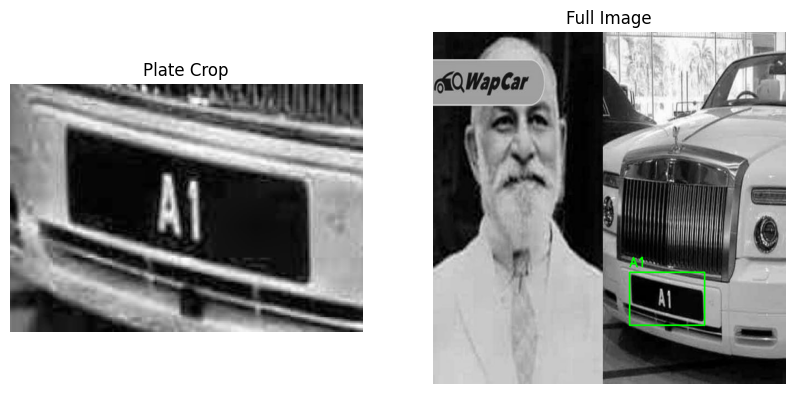


🔹 Processing: dst_nombor-plate-teksi-malaysia_258_jpeg_jpg.rf.0513319b4775cb2a43bb6c23cc5025a4.jpg
➡️ Plate: HQ1991 (conf=1.00)


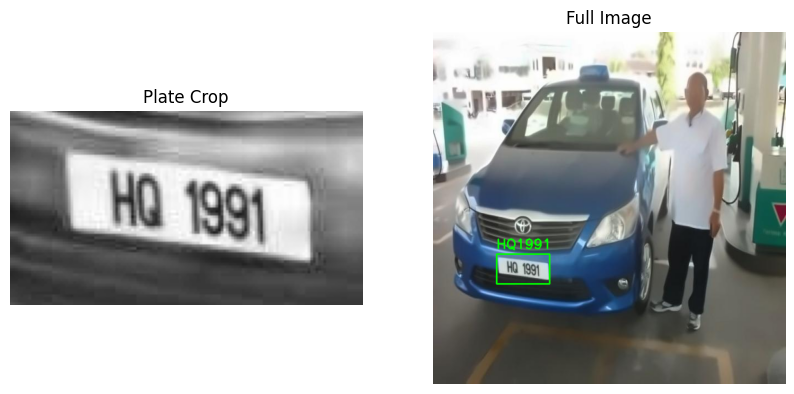


🔹 Processing: gray_nombor-plate-kerata-serawak-dan-sabah_31_png_jpg.rf.f8baf73e0e4d2683fdbd67eb7c75eb10.jpg
➡️ Plate: Invalid : WAE (conf=0.32)


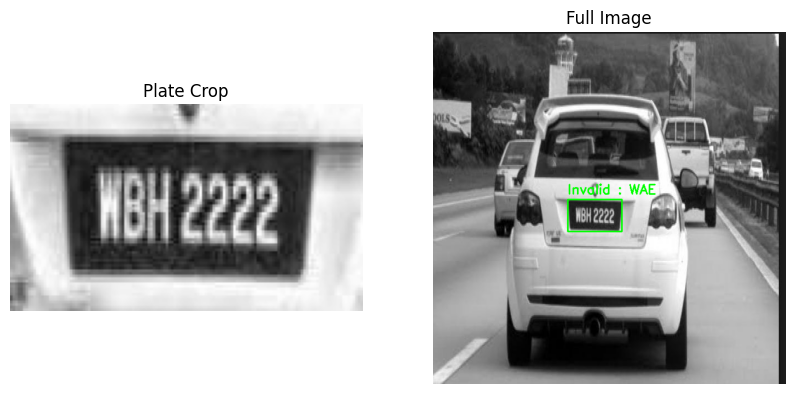


🔹 Processing: dst_carplate18_jpg.rf.c03ae99301bc7d434ec8f8d86f30d0ad.jpg
➡️ Plate: BMM4149 (conf=0.94)


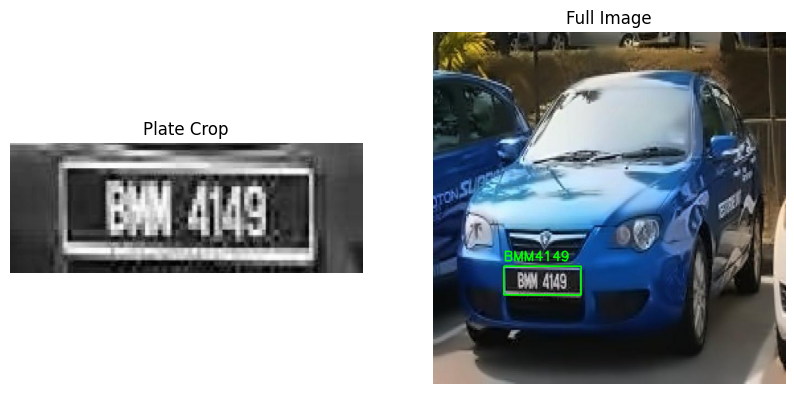


🔹 Processing: dst_nombor-plate-kerata-serawak-dan-sabah_255_jpeg_jpg.rf.584a9fef96b8384c960757bc58db6d73.jpg
➡️ Plate: HJA8888 (conf=0.76)


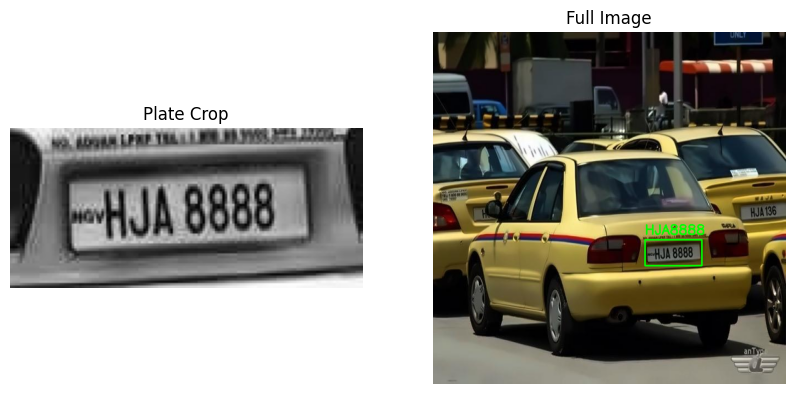

➡️ Plate: Invalid : MAJA (conf=0.84)


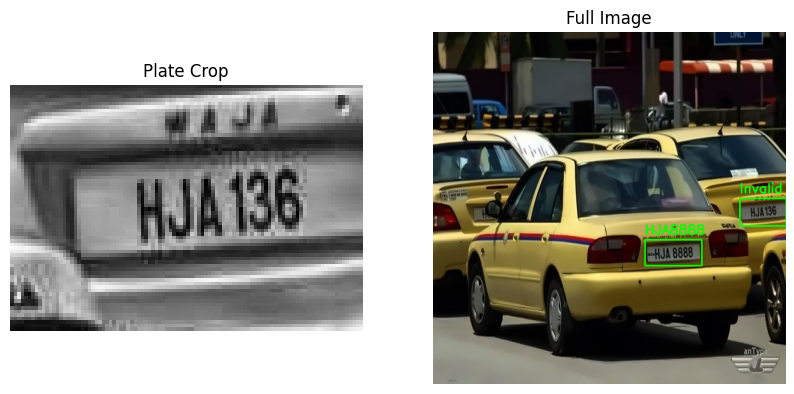

➡️ Plate: Invalid :  (conf=0.00)


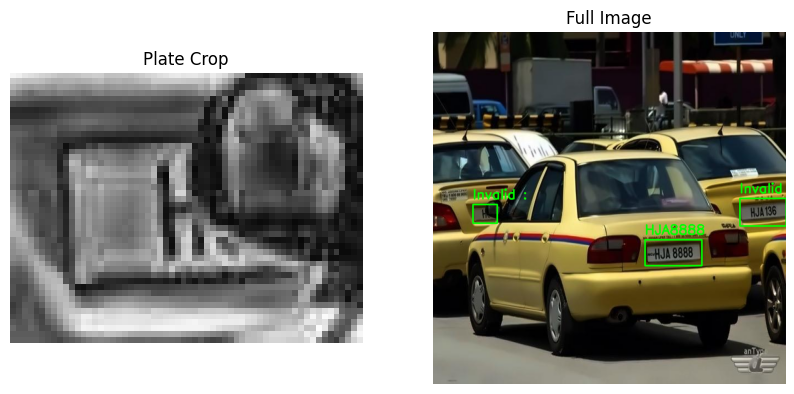

➡️ Plate: Invalid : DNLY (conf=0.93)


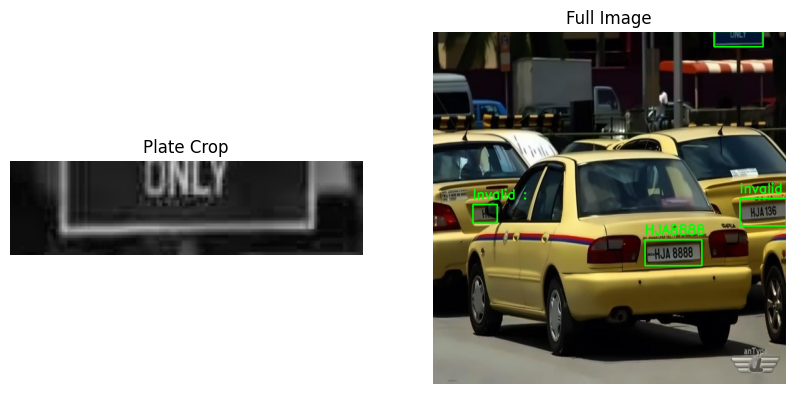


🔹 Processing: gray_malaysia-custom-car-plates_28_jpeg_jpg.rf.dabb73219f6c89d419f61ba45170cecd.jpg
➡️ Plate: PEN15 (conf=0.93)


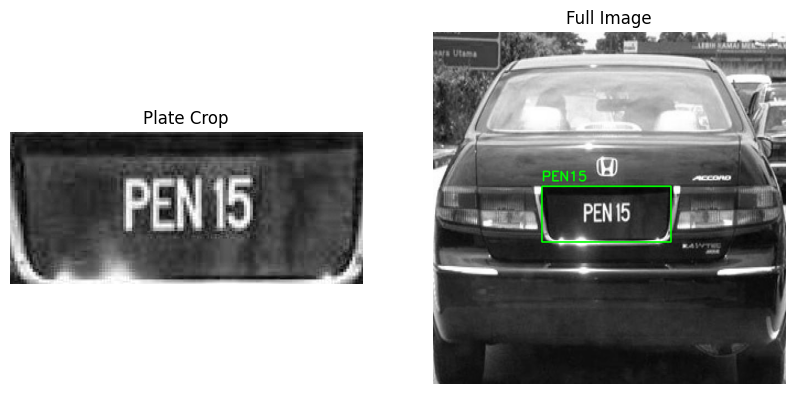


🔹 Processing: gray_carplate15_jpg.rf.df5c7a1ffb2932d2f738c4724d993030.jpg
➡️ Plate: KN232 (conf=1.00)


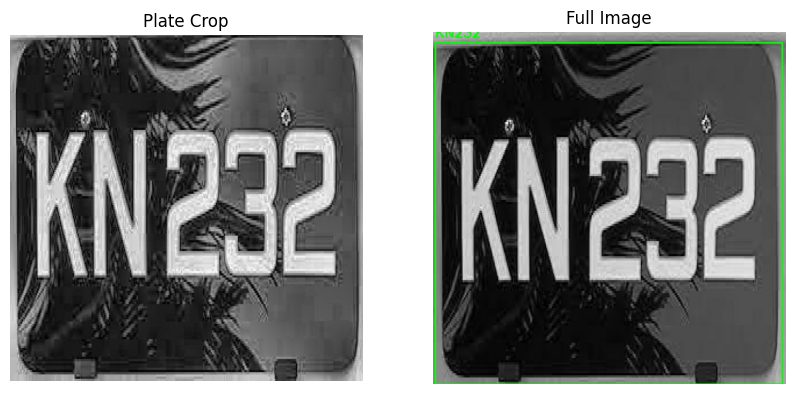


🔹 Processing: carplate49_jpg.rf.10e1c820dda8db5ec0967cf2e87abac5.jpg
➡️ Plate: HWC2012 (conf=0.90)


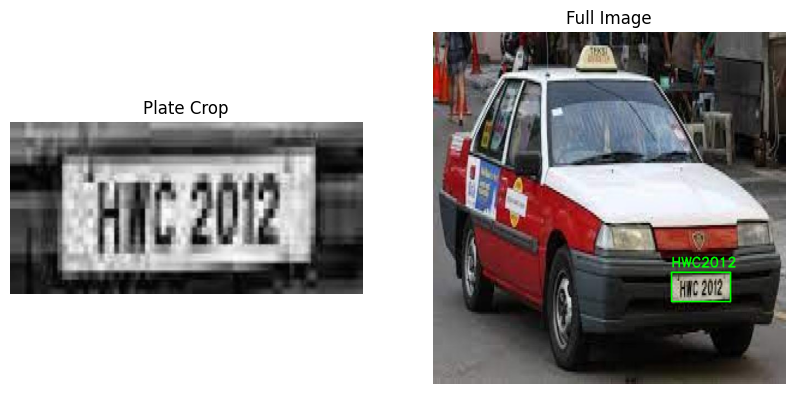


🔹 Processing: gray_malaysia-car-plate-number_12_jpeg_jpg.rf.f009ff3bdc1179a5396697a0d7b7447c.jpg
➡️ Plate: Invalid : 6666W (conf=0.72)


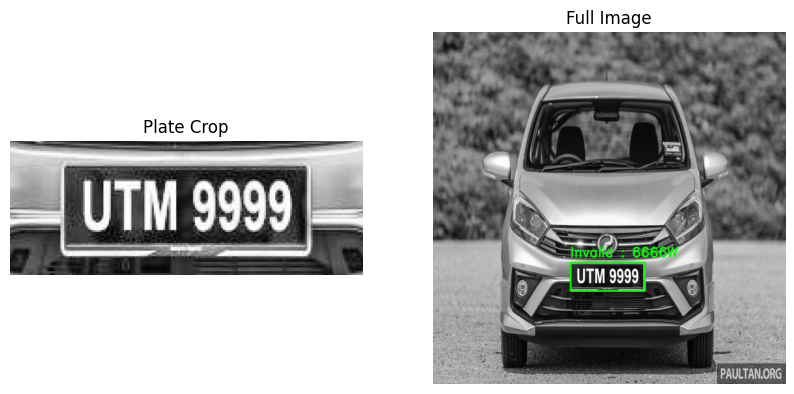


🔹 Processing: dst_carplate13_jpg.rf.ee22be89f78b37ab09e7714a0f6d11d7.jpg
➡️ Plate: Invalid : 88XX (conf=0.87)


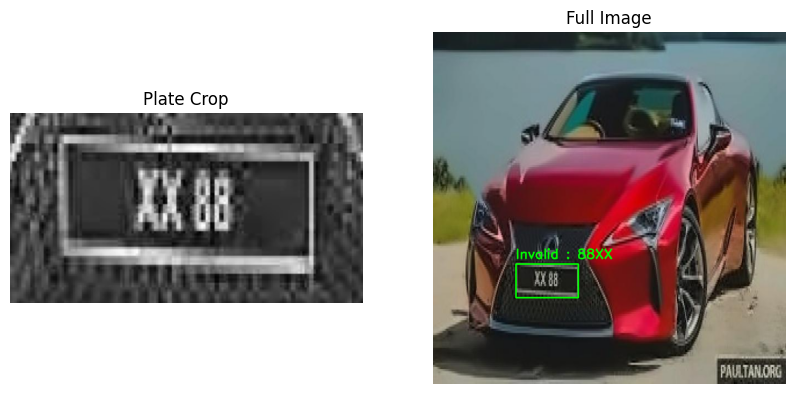


🔹 Processing: IMG_8054_jpg.rf.647b31d2b063f7405da74d7f9ead5426.jpg
➡️ Plate: AMY2831 (conf=1.00)


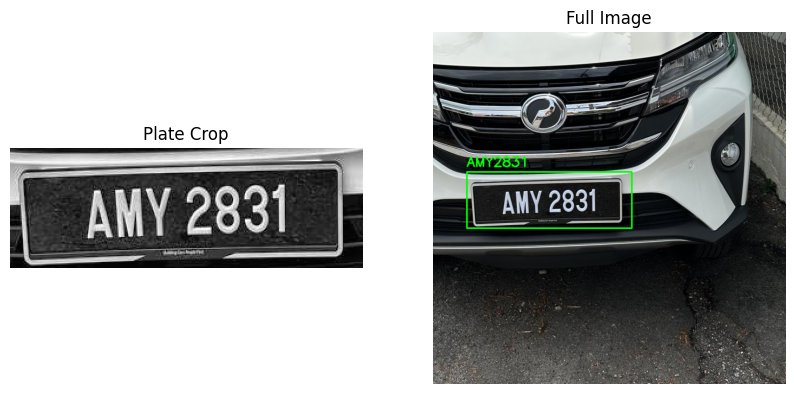


🔹 Processing: dst_carplate5_jpg.rf.3eaf43dec4c35612b8a6dc092215594a.jpg
➡️ Plate: JQK6888 (conf=1.00)


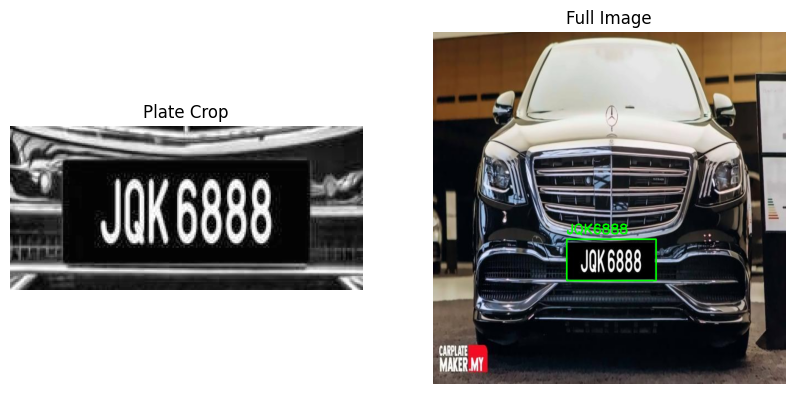


🔹 Processing: gray_malaysia-car-plate-number_13_jpeg_jpg.rf.959a3292d2ff2f4cd30ca6a5e07e435a.jpg
➡️ Plate: YA8055 (conf=0.99)


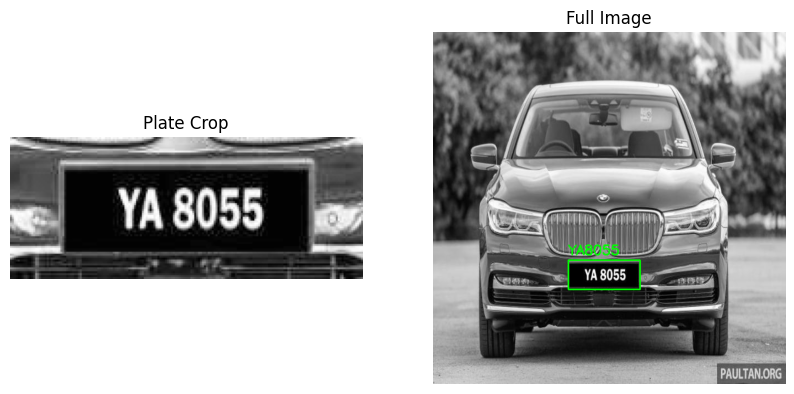


🔹 Processing: abbb718d-f9e1-45d9-9245-3f0c5b4249fb_jpg.rf.305cb37a21af84b698d7b4dc71a1887f.jpg
➡️ Plate: VCT9264 (conf=1.00)


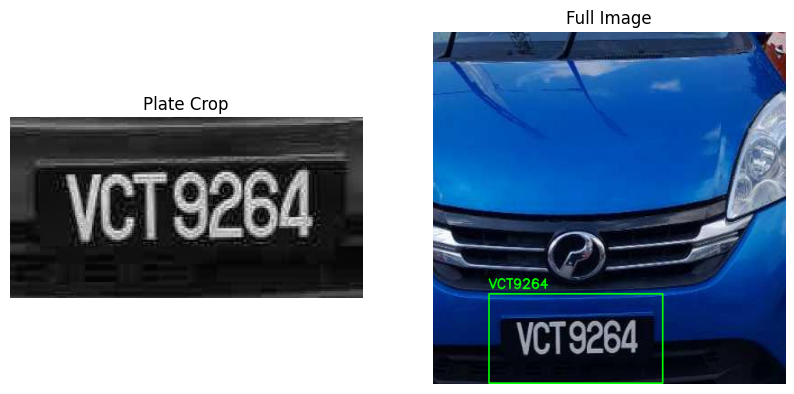


🔹 Processing: gray_malaysia-custom-car-plates_17_jpeg_jpg.rf.936859c6a1507c3f8892c69e5383fc34.jpg
➡️ Plate: Invalid : 1M (conf=1.00)


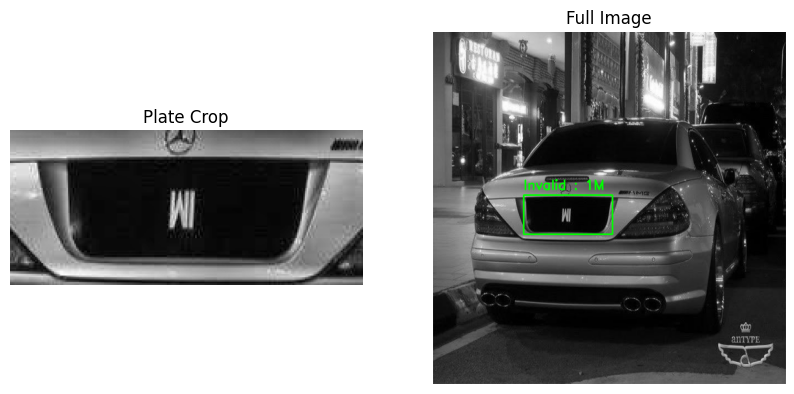


🔹 Processing: 3f7bbcb9-9c47-4950-8e53-012e36bb2acc-1-_jpg.rf.52ca16153522bb635ce255a04b51aa47.jpg
➡️ Plate: JRC5492 (conf=0.98)


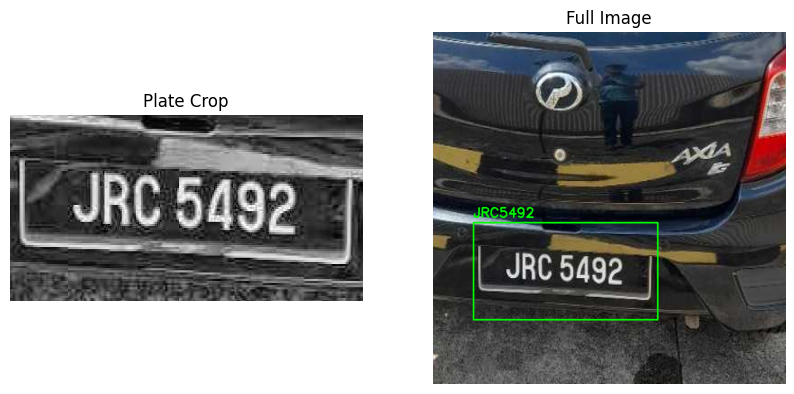


🔹 Processing: f787f1a2-82e4-4726-89cf-ca929c68eafe_jpg.rf.5eb37cd1e1a444aa606dd9946552e6f4.jpg

🔹 Processing: gray_carplate51_jpg.rf.244f1ad489185752fa5fa0656be77c27.jpg
➡️ Plate: W4575K (conf=1.00)


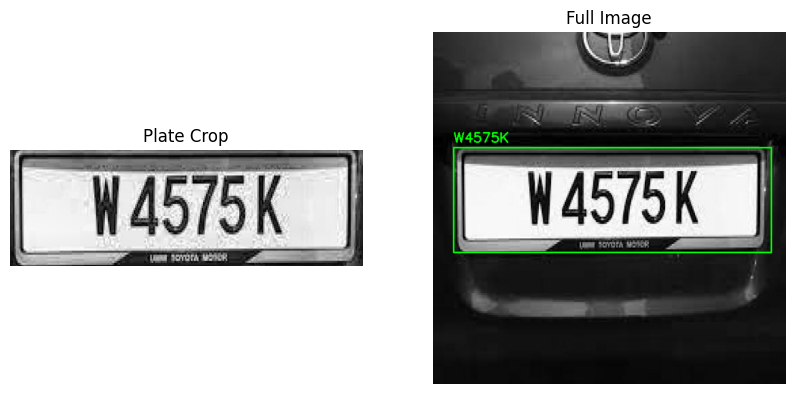


🔹 Processing: carplate38_jpg.rf.4cdb09a07b2ae8d05be66221a873fea2.jpg

🔹 Processing: gray_carplate33_jpg.rf.589ef842108540adc0f9b64a53323dc3.jpg
➡️ Plate: WWV8993 (conf=0.97)


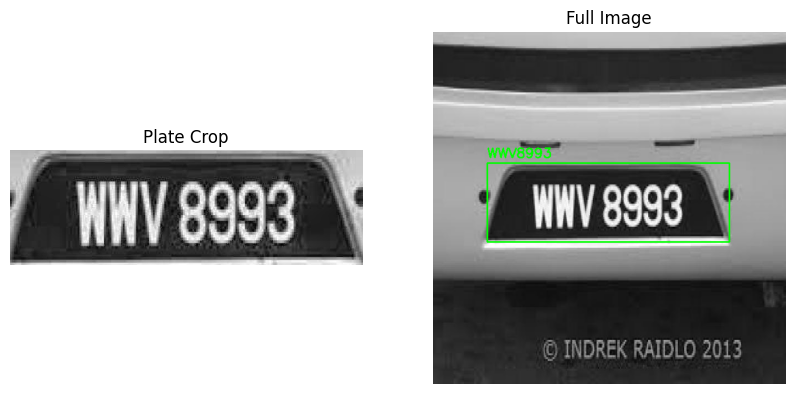


✅ OCR results with confidence saved to ocr_results_modelA.csv


In [ ]:
# Detect car plate from images
# Model A
results_list = []
detector = PlateDetection("./model/modelA/weights/best.pt")

for filename in os.listdir(test_path):
    if filename.lower().endswith(('.jpg', '.jpeg', '.png')):
        img_path = os.path.join(test_path, filename)
        print(f"\n🔹 Processing: {filename}")
        detector.detect_plate(img_path)

# Save all results to CSV
df = pd.DataFrame(results_list)
df.to_csv("ocr_results_modelA.csv", index=False)
print("\n✅ OCR results with confidence saved to ocr_results_modelA.csv")

Creating model: ('PP-LCNet_x1_0_doc_ori', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models/PP-LCNet_x1_0_doc_ori`.
Creating model: ('UVDoc', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models/UVDoc`.
Creating model: ('PP-LCNet_x1_0_textline_ori', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models/PP-LCNet_x1_0_textline_ori`.
Creating model: ('PP-OCRv5_server_det', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models/PP-OCRv5_server_det`.
Creating model: ('en_PP-OCRv5_mobile_rec', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models


🔹 Processing: gray_malaysia-car-plates_12_jpeg_jpg.rf.c5d4b85fb8dbd796d0563b7dedb72eac.jpg
➡️ Plate: A1 (conf=0.96)


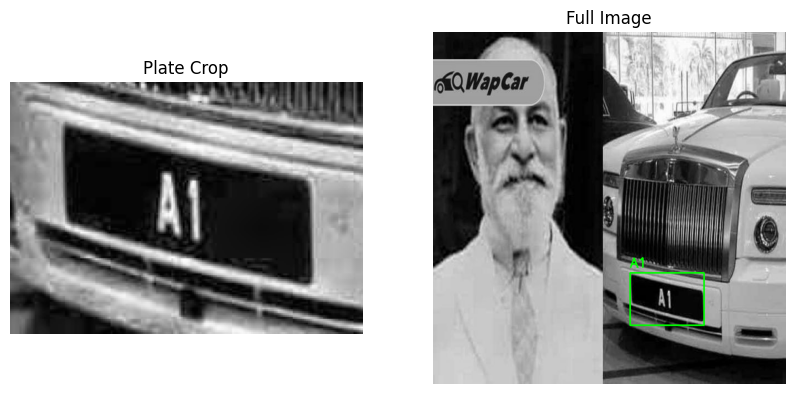


🔹 Processing: dst_nombor-plate-teksi-malaysia_258_jpeg_jpg.rf.0513319b4775cb2a43bb6c23cc5025a4.jpg
➡️ Plate: HQ1991 (conf=1.00)


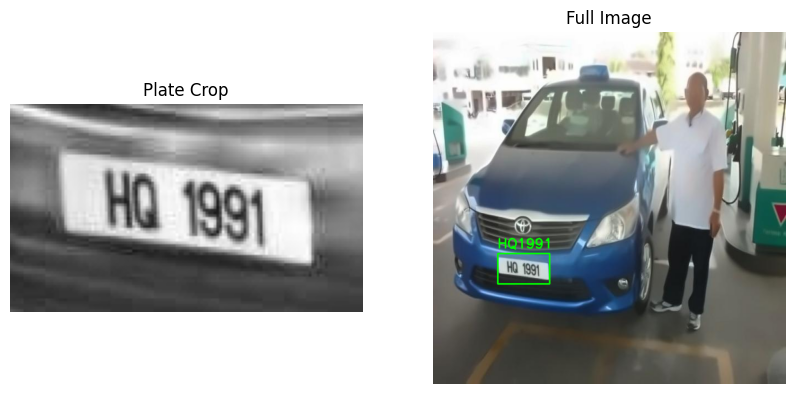


🔹 Processing: gray_nombor-plate-kerata-serawak-dan-sabah_31_png_jpg.rf.f8baf73e0e4d2683fdbd67eb7c75eb10.jpg
➡️ Plate: WBH2222 (conf=0.95)


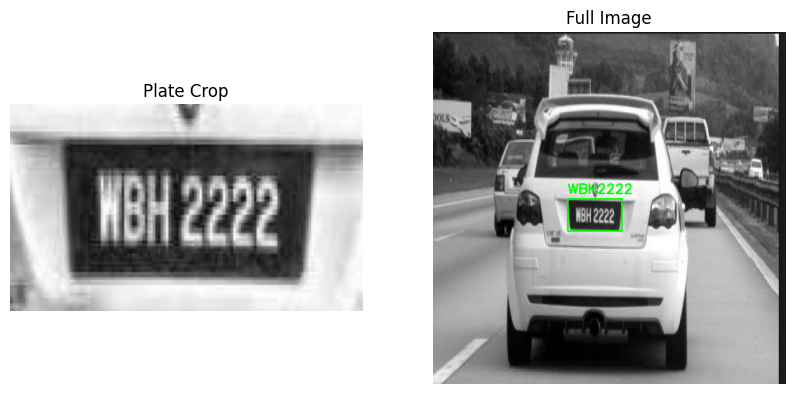


🔹 Processing: dst_carplate18_jpg.rf.c03ae99301bc7d434ec8f8d86f30d0ad.jpg
➡️ Plate: BMM4149 (conf=0.99)


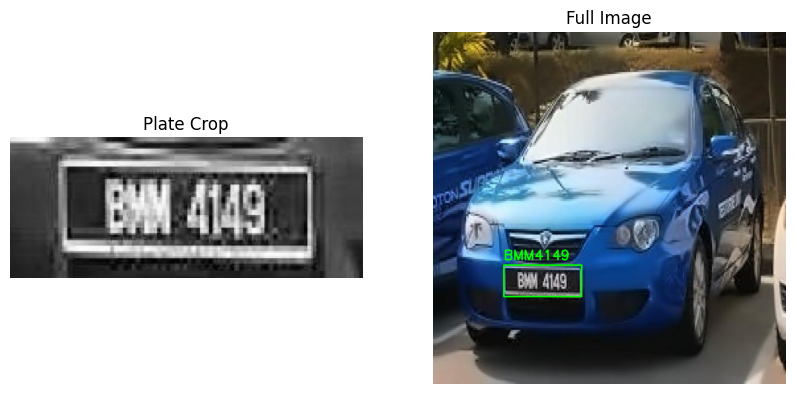


🔹 Processing: dst_nombor-plate-kerata-serawak-dan-sabah_255_jpeg_jpg.rf.584a9fef96b8384c960757bc58db6d73.jpg
➡️ Plate: HJA8888 (conf=0.83)


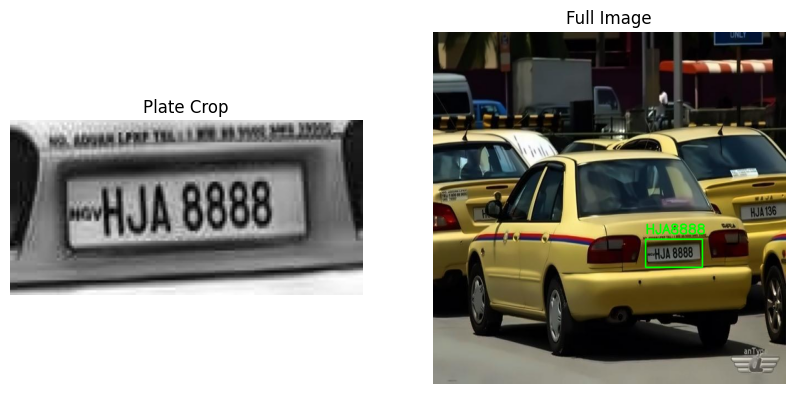

➡️ Plate: Invalid : QNLY (conf=0.87)


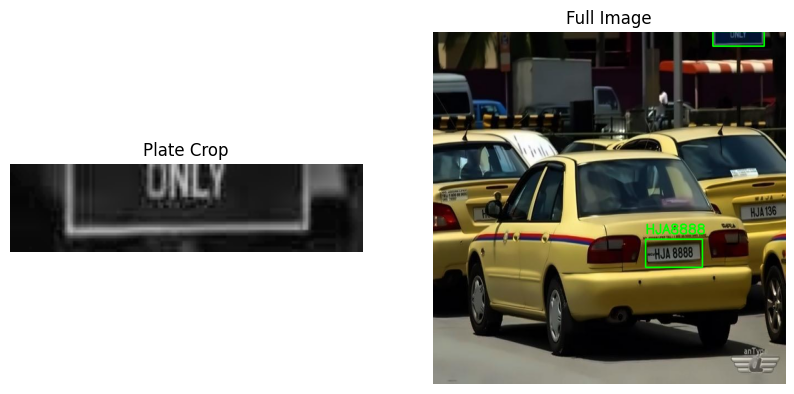

➡️ Plate: Invalid : WAJA (conf=0.77)


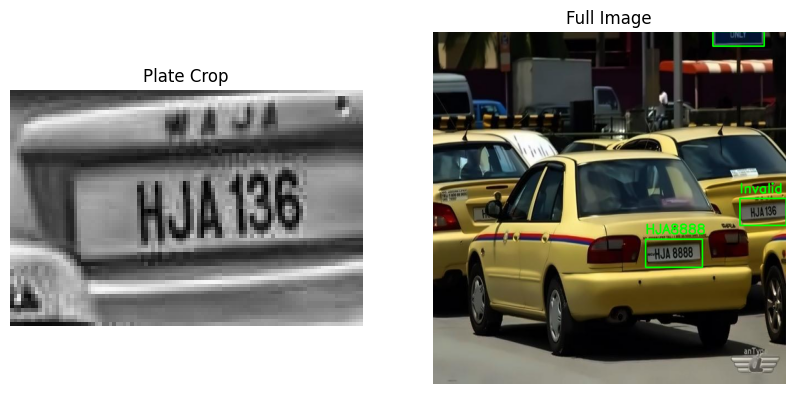

➡️ Plate: Invalid :  (conf=0.00)


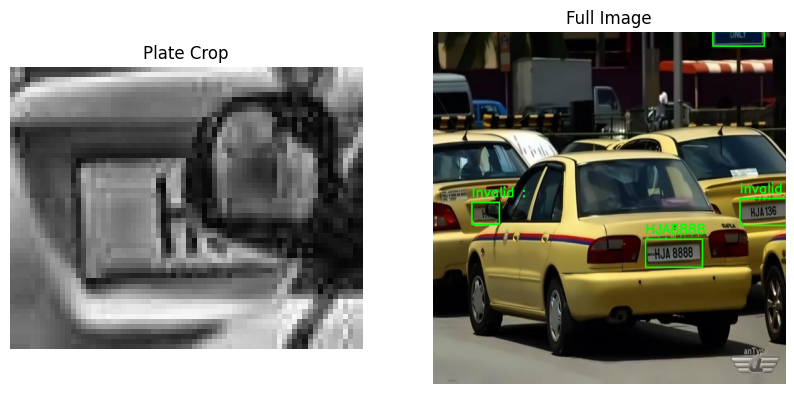


🔹 Processing: gray_malaysia-custom-car-plates_28_jpeg_jpg.rf.dabb73219f6c89d419f61ba45170cecd.jpg
➡️ Plate: PEN15 (conf=1.00)


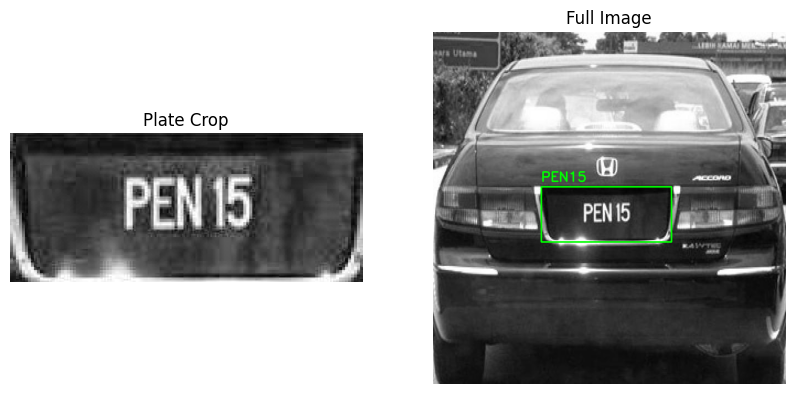


🔹 Processing: gray_carplate15_jpg.rf.df5c7a1ffb2932d2f738c4724d993030.jpg
➡️ Plate: Invalid : ZEZNN (conf=0.42)


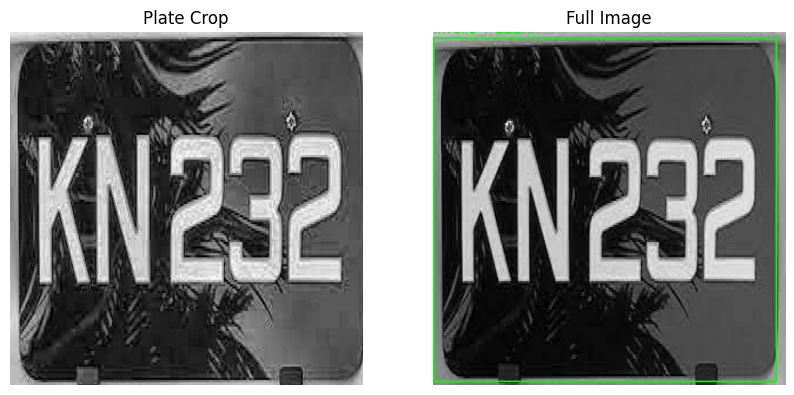


🔹 Processing: carplate49_jpg.rf.10e1c820dda8db5ec0967cf2e87abac5.jpg
➡️ Plate: HWC2012 (conf=0.98)


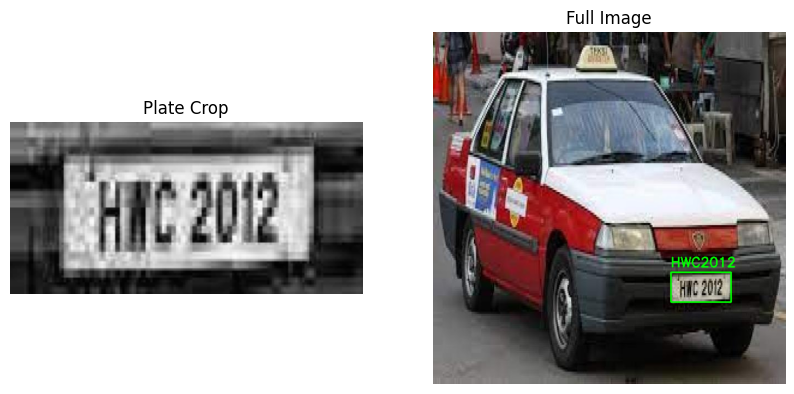


🔹 Processing: gray_malaysia-car-plate-number_12_jpeg_jpg.rf.f009ff3bdc1179a5396697a0d7b7447c.jpg
➡️ Plate: Invalid : 6666W (conf=0.81)


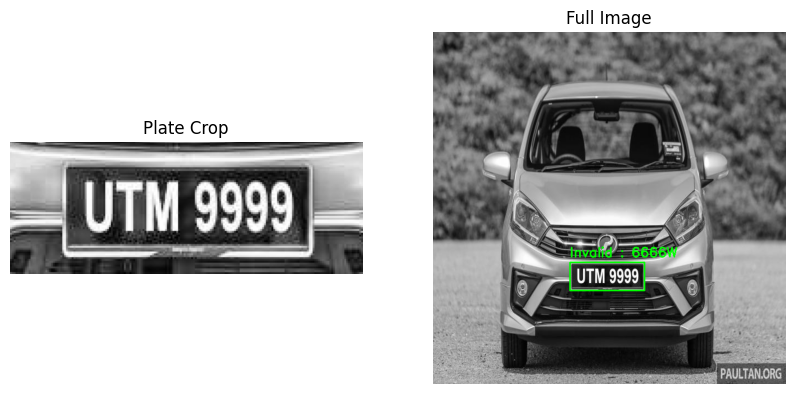


🔹 Processing: dst_carplate13_jpg.rf.ee22be89f78b37ab09e7714a0f6d11d7.jpg
➡️ Plate: XX88 (conf=0.91)


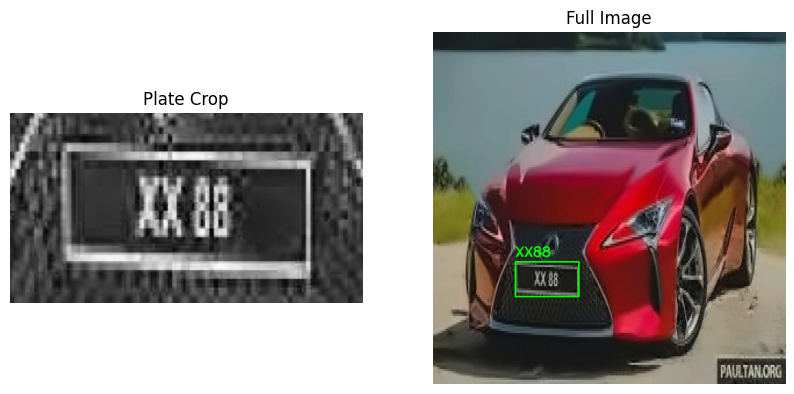


🔹 Processing: IMG_8054_jpg.rf.647b31d2b063f7405da74d7f9ead5426.jpg
➡️ Plate: AMY2831 (conf=1.00)


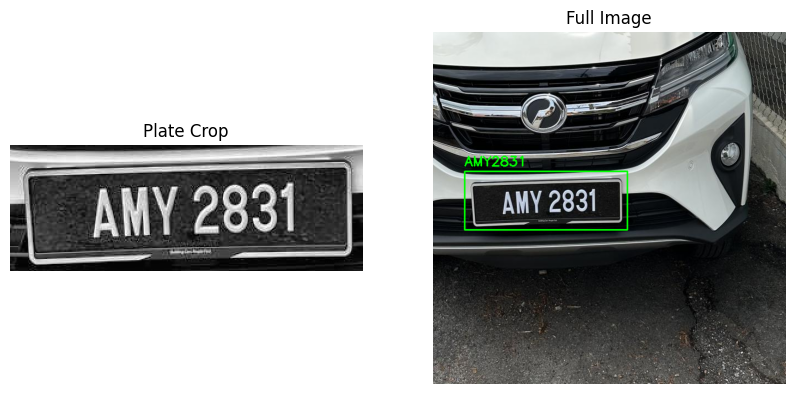


🔹 Processing: dst_carplate5_jpg.rf.3eaf43dec4c35612b8a6dc092215594a.jpg
➡️ Plate: JQK6888 (conf=0.94)


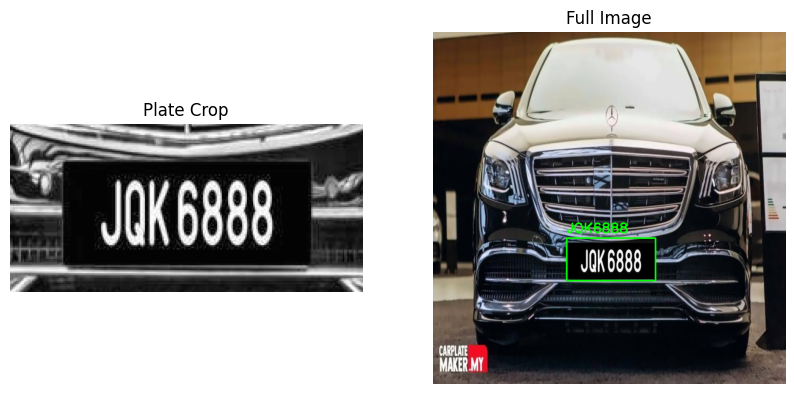


🔹 Processing: gray_malaysia-car-plate-number_13_jpeg_jpg.rf.959a3292d2ff2f4cd30ca6a5e07e435a.jpg
➡️ Plate: YA8055 (conf=0.99)


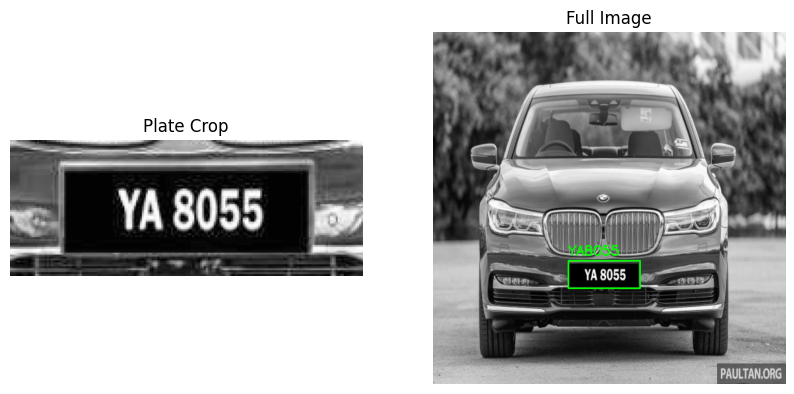


🔹 Processing: abbb718d-f9e1-45d9-9245-3f0c5b4249fb_jpg.rf.305cb37a21af84b698d7b4dc71a1887f.jpg
➡️ Plate: VCT9264 (conf=1.00)


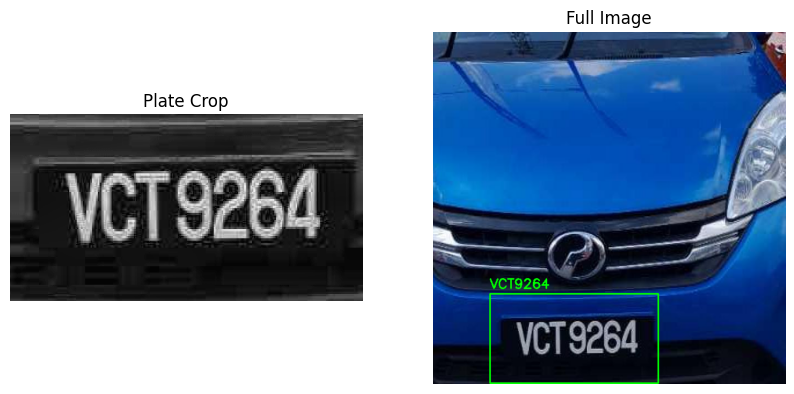


🔹 Processing: gray_malaysia-custom-car-plates_17_jpeg_jpg.rf.936859c6a1507c3f8892c69e5383fc34.jpg
➡️ Plate: Invalid : 1M (conf=1.00)


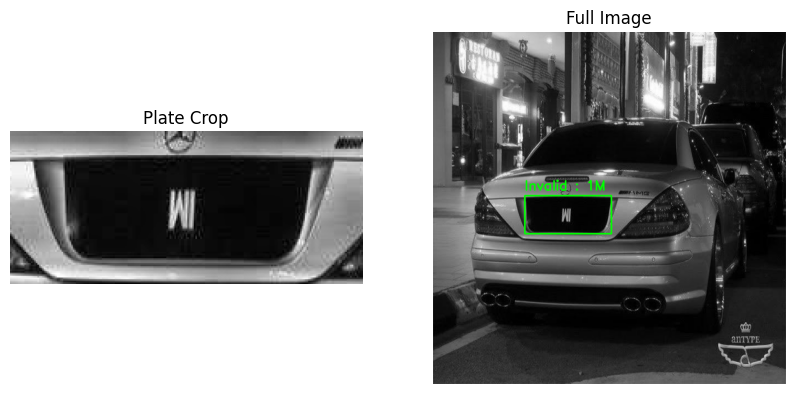


🔹 Processing: 3f7bbcb9-9c47-4950-8e53-012e36bb2acc-1-_jpg.rf.52ca16153522bb635ce255a04b51aa47.jpg
➡️ Plate: JRC5492 (conf=1.00)


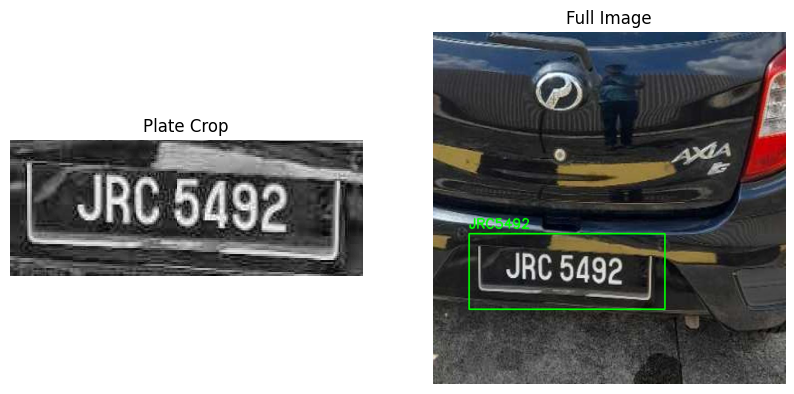


🔹 Processing: f787f1a2-82e4-4726-89cf-ca929c68eafe_jpg.rf.5eb37cd1e1a444aa606dd9946552e6f4.jpg
➡️ Plate: VL716 (conf=0.99)


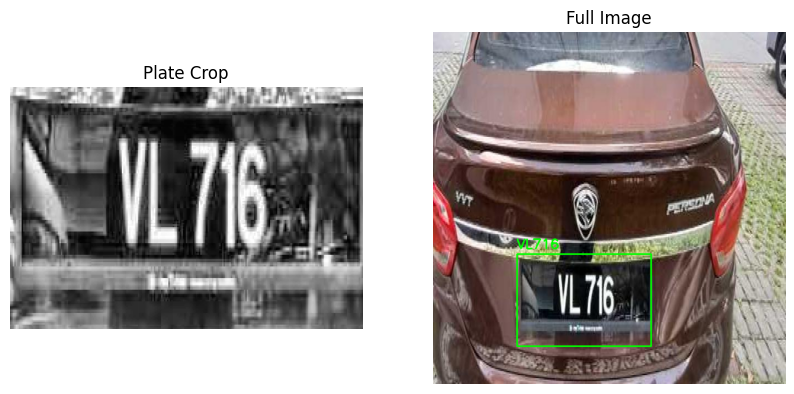


🔹 Processing: gray_carplate51_jpg.rf.244f1ad489185752fa5fa0656be77c27.jpg
➡️ Plate: W4575K (conf=1.00)


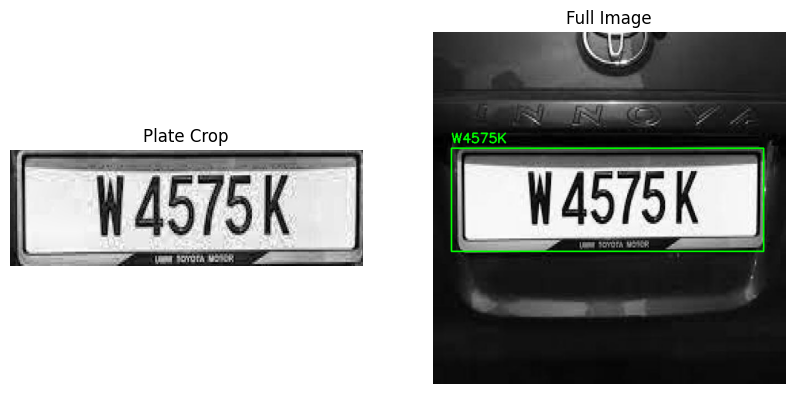


🔹 Processing: carplate38_jpg.rf.4cdb09a07b2ae8d05be66221a873fea2.jpg
➡️ Plate: Invalid :  (conf=0.00)


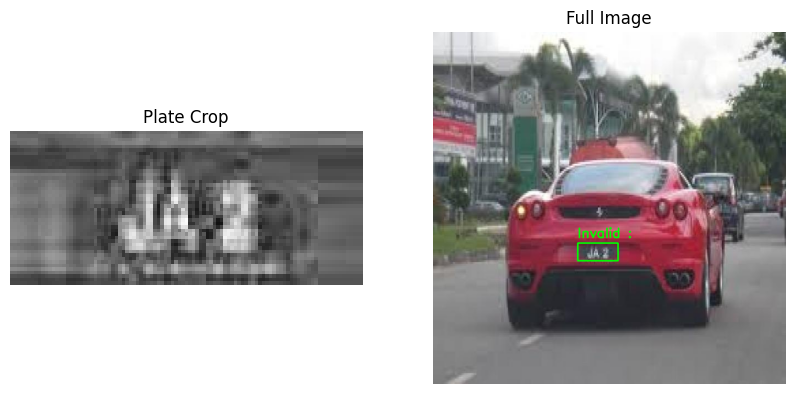


🔹 Processing: gray_carplate33_jpg.rf.589ef842108540adc0f9b64a53323dc3.jpg
➡️ Plate: WWV8993 (conf=0.93)


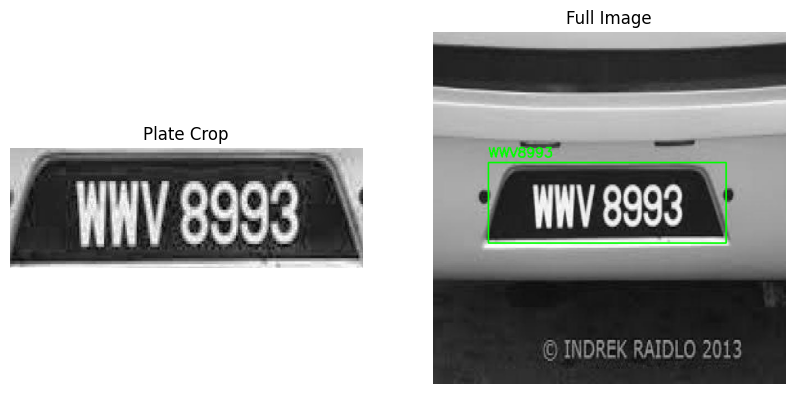


✅ OCR results with confidence saved to ocr_results_modelB.csv


In [ ]:
# Model B
results_list = []
detector = PlateDetection("./model/modelB/weights/best.pt")

for filename in os.listdir(test_path):
    if filename.lower().endswith(('.jpg', '.jpeg', '.png')):
        img_path = os.path.join(test_path, filename)
        print(f"\n🔹 Processing: {filename}")
        detector.detect_plate(img_path)

# Save all results to CSV
df = pd.DataFrame(results_list)
df.to_csv("ocr_results_modelB.csv", index=False)
print("\n✅ OCR results with confidence saved to ocr_results_modelB.csv")

Creating model: ('PP-LCNet_x1_0_doc_ori', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models/PP-LCNet_x1_0_doc_ori`.
Creating model: ('UVDoc', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models/UVDoc`.
Creating model: ('PP-LCNet_x1_0_textline_ori', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models/PP-LCNet_x1_0_textline_ori`.
Creating model: ('PP-OCRv5_server_det', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models/PP-OCRv5_server_det`.
Creating model: ('en_PP-OCRv5_mobile_rec', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models


🔹 Processing: gray_malaysia-car-plates_12_jpeg_jpg.rf.c5d4b85fb8dbd796d0563b7dedb72eac.jpg
➡️ Plate: A1 (conf=0.98)


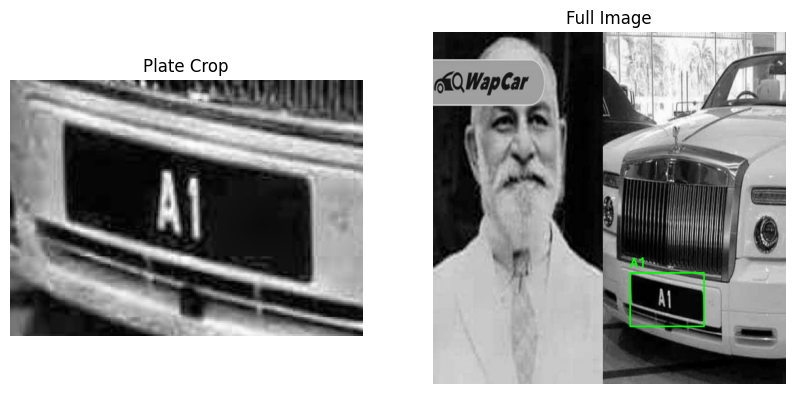


🔹 Processing: dst_nombor-plate-teksi-malaysia_258_jpeg_jpg.rf.0513319b4775cb2a43bb6c23cc5025a4.jpg
➡️ Plate: HQ1991 (conf=1.00)


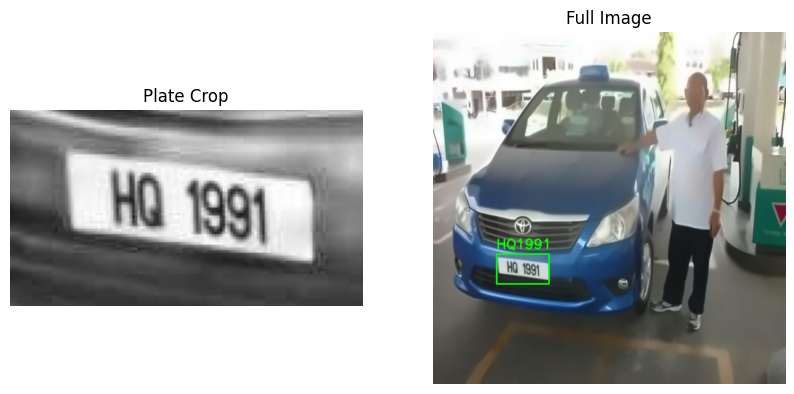


🔹 Processing: gray_nombor-plate-kerata-serawak-dan-sabah_31_png_jpg.rf.f8baf73e0e4d2683fdbd67eb7c75eb10.jpg
➡️ Plate: WBH2222 (conf=0.94)


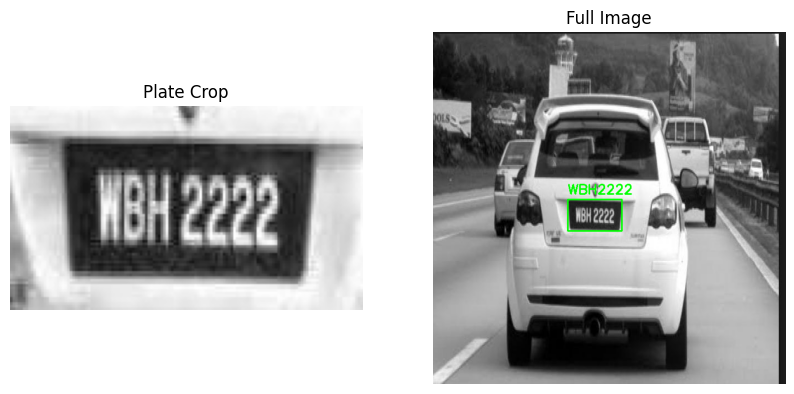


🔹 Processing: dst_carplate18_jpg.rf.c03ae99301bc7d434ec8f8d86f30d0ad.jpg
➡️ Plate: BMM4149 (conf=0.99)


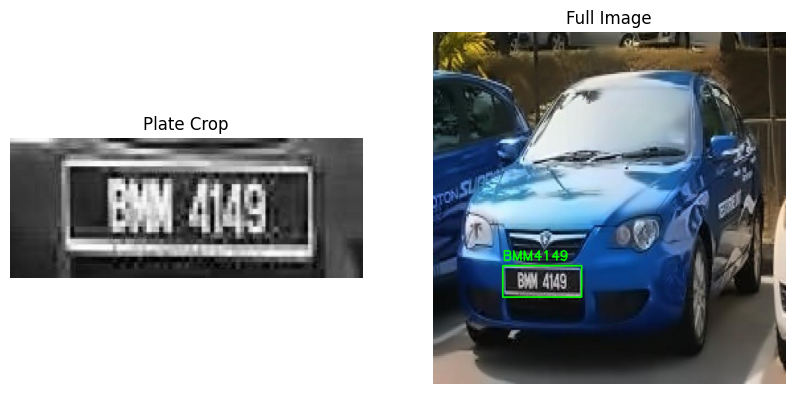


🔹 Processing: dst_nombor-plate-kerata-serawak-dan-sabah_255_jpeg_jpg.rf.584a9fef96b8384c960757bc58db6d73.jpg
➡️ Plate: HJA8888 (conf=0.90)


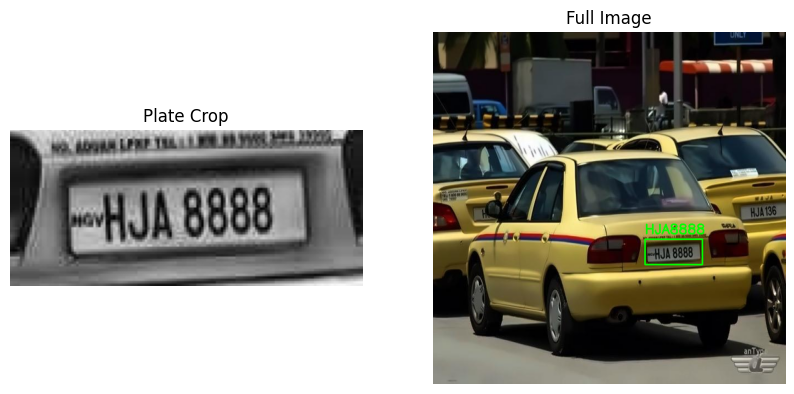

➡️ Plate: HJA136 (conf=0.99)


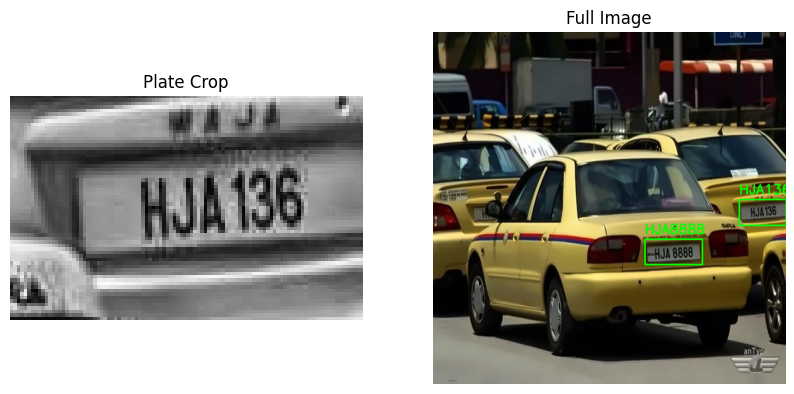

➡️ Plate: Invalid : QNL (conf=0.89)


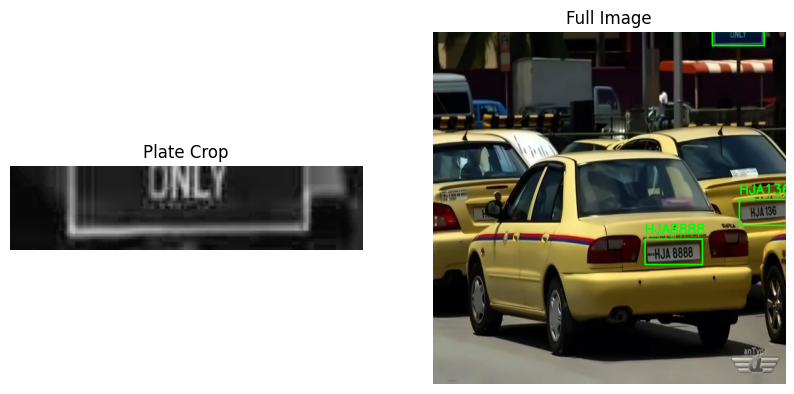

➡️ Plate: Invalid :  (conf=0.00)


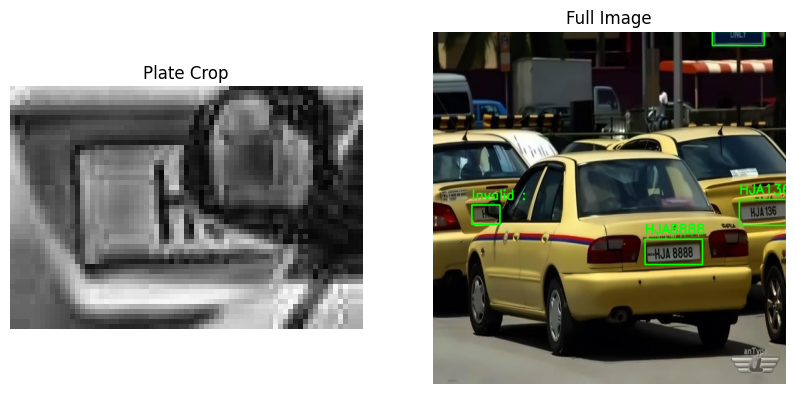


🔹 Processing: gray_malaysia-custom-car-plates_28_jpeg_jpg.rf.dabb73219f6c89d419f61ba45170cecd.jpg
➡️ Plate: PEN15 (conf=1.00)


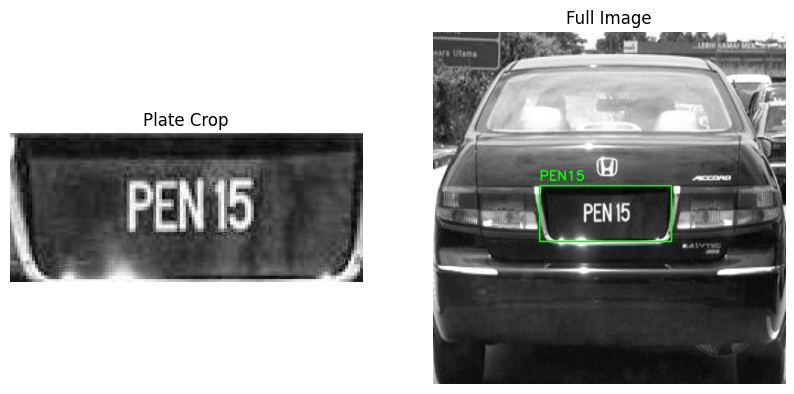


🔹 Processing: gray_carplate15_jpg.rf.df5c7a1ffb2932d2f738c4724d993030.jpg
➡️ Plate: KN232 (conf=0.97)


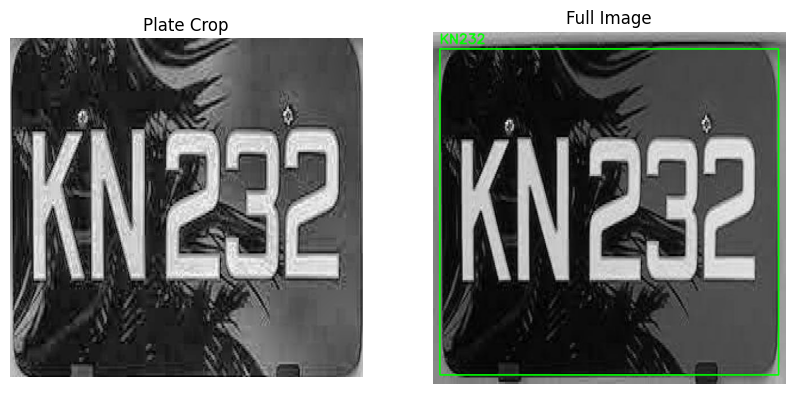


🔹 Processing: carplate49_jpg.rf.10e1c820dda8db5ec0967cf2e87abac5.jpg
➡️ Plate: HWC2012 (conf=0.92)


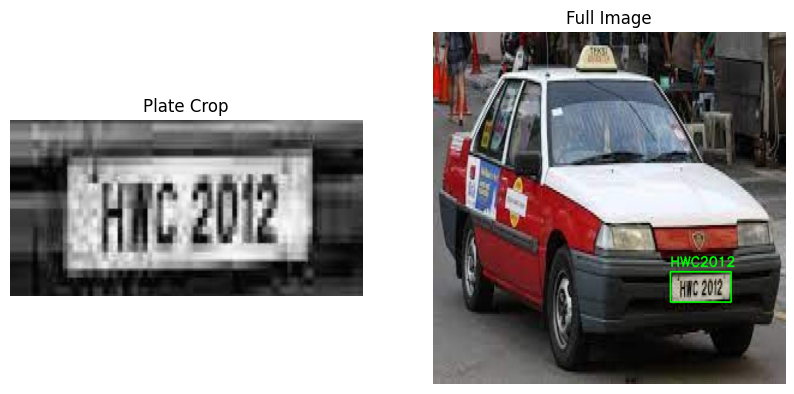


🔹 Processing: gray_malaysia-car-plate-number_12_jpeg_jpg.rf.f009ff3bdc1179a5396697a0d7b7447c.jpg
➡️ Plate: Invalid : 6666W (conf=0.72)


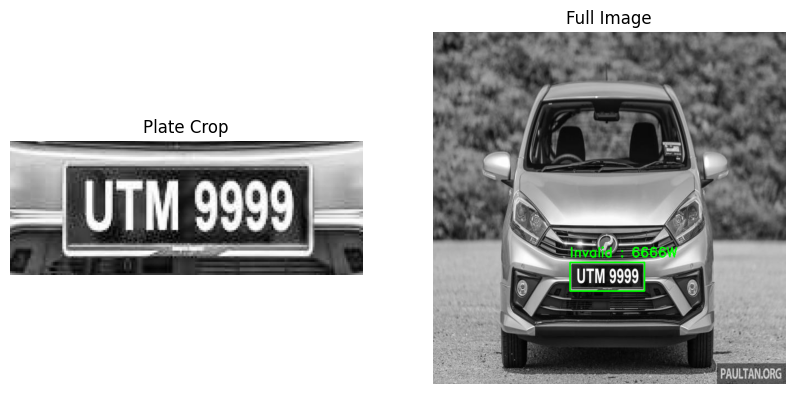


🔹 Processing: dst_carplate13_jpg.rf.ee22be89f78b37ab09e7714a0f6d11d7.jpg
➡️ Plate: Invalid : 88XX (conf=0.96)


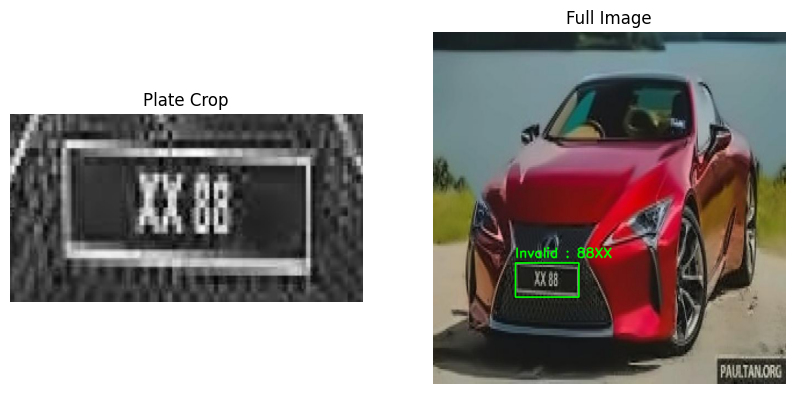


🔹 Processing: IMG_8054_jpg.rf.647b31d2b063f7405da74d7f9ead5426.jpg
➡️ Plate: AMY2831 (conf=1.00)


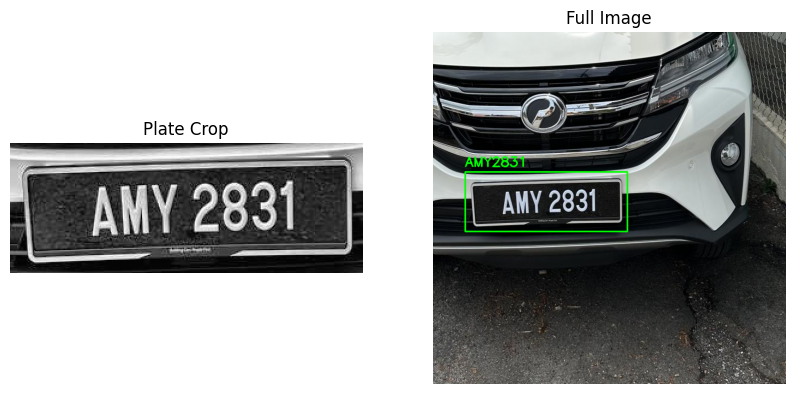


🔹 Processing: dst_carplate5_jpg.rf.3eaf43dec4c35612b8a6dc092215594a.jpg
➡️ Plate: JQK6888 (conf=1.00)


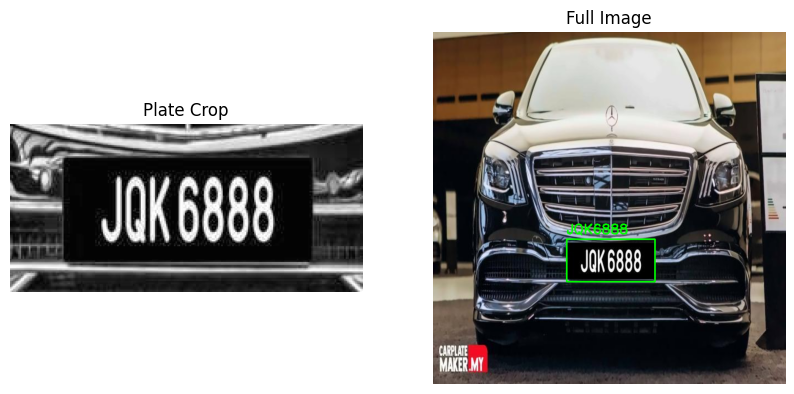


🔹 Processing: gray_malaysia-car-plate-number_13_jpeg_jpg.rf.959a3292d2ff2f4cd30ca6a5e07e435a.jpg
➡️ Plate: YA8055 (conf=1.00)


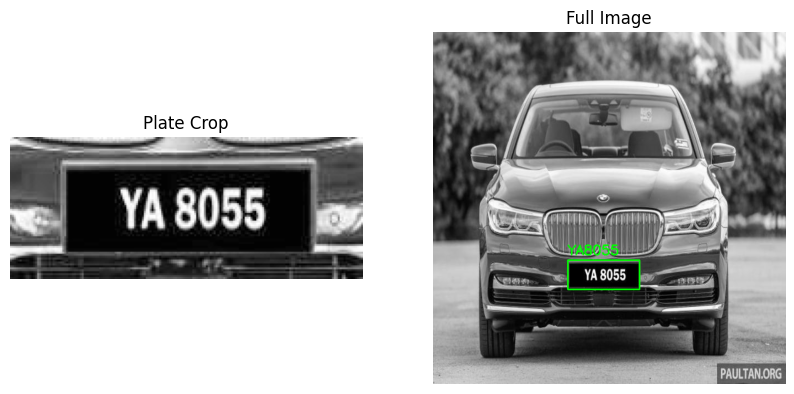


🔹 Processing: abbb718d-f9e1-45d9-9245-3f0c5b4249fb_jpg.rf.305cb37a21af84b698d7b4dc71a1887f.jpg
➡️ Plate: VCT9264 (conf=1.00)


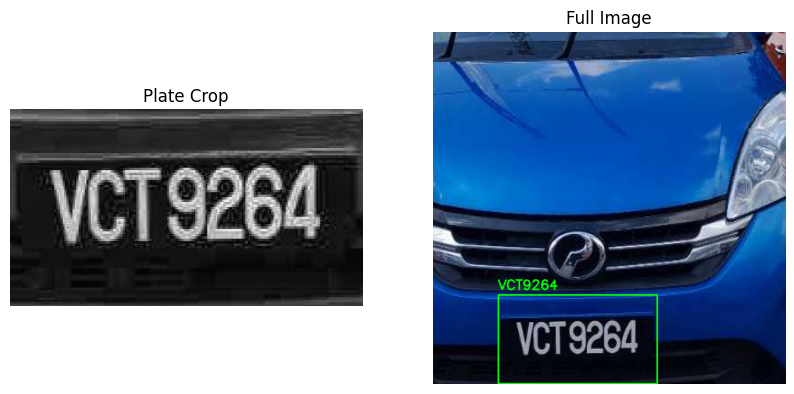


🔹 Processing: gray_malaysia-custom-car-plates_17_jpeg_jpg.rf.936859c6a1507c3f8892c69e5383fc34.jpg
➡️ Plate: Invalid : 1M (conf=1.00)


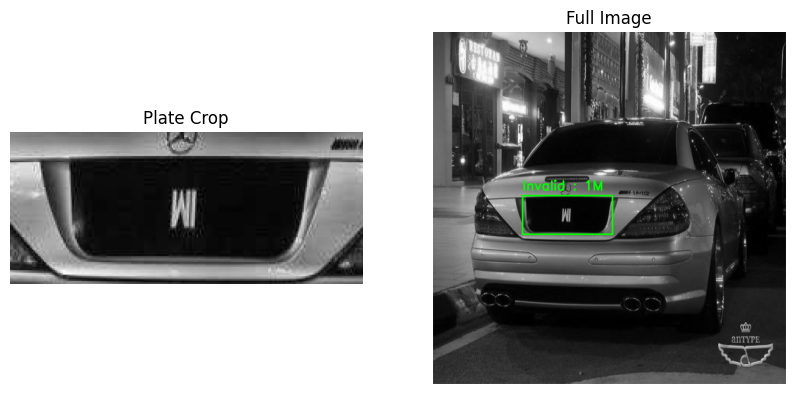


🔹 Processing: 3f7bbcb9-9c47-4950-8e53-012e36bb2acc-1-_jpg.rf.52ca16153522bb635ce255a04b51aa47.jpg
➡️ Plate: JRC5492 (conf=0.97)


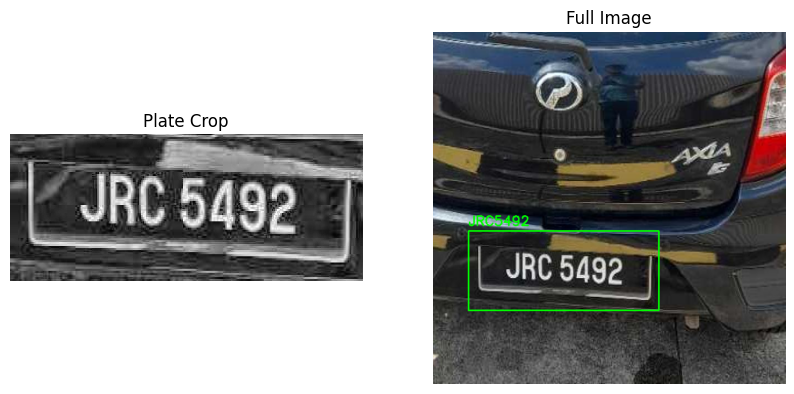


🔹 Processing: f787f1a2-82e4-4726-89cf-ca929c68eafe_jpg.rf.5eb37cd1e1a444aa606dd9946552e6f4.jpg
➡️ Plate: Invalid :  (conf=0.00)


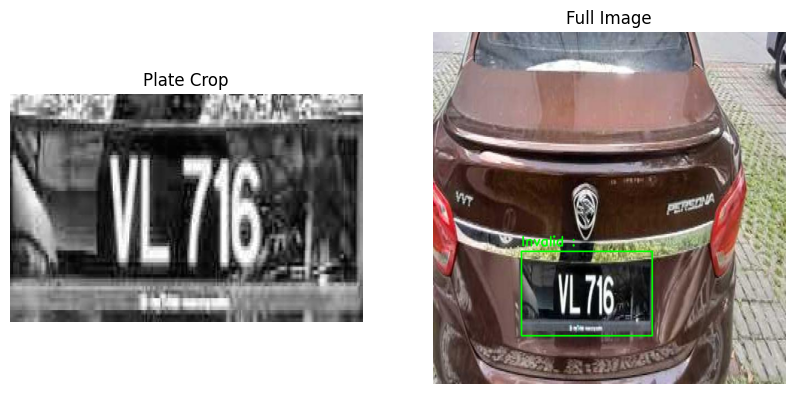


🔹 Processing: gray_carplate51_jpg.rf.244f1ad489185752fa5fa0656be77c27.jpg
➡️ Plate: W4575K (conf=1.00)


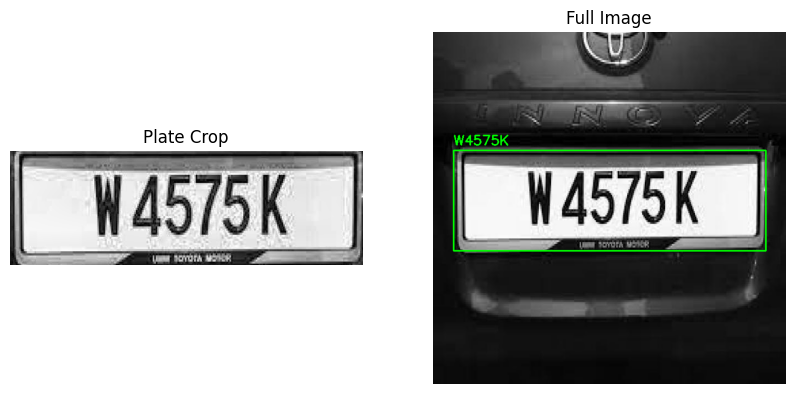

➡️ Plate: Invalid :  (conf=0.00)


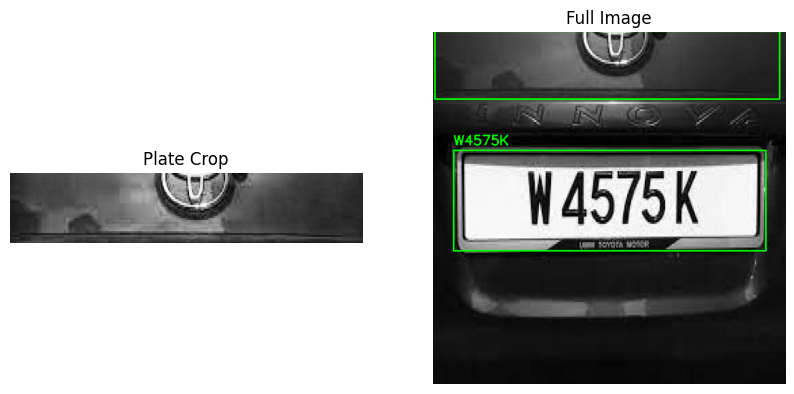


🔹 Processing: carplate38_jpg.rf.4cdb09a07b2ae8d05be66221a873fea2.jpg
➡️ Plate: Invalid :  (conf=0.00)


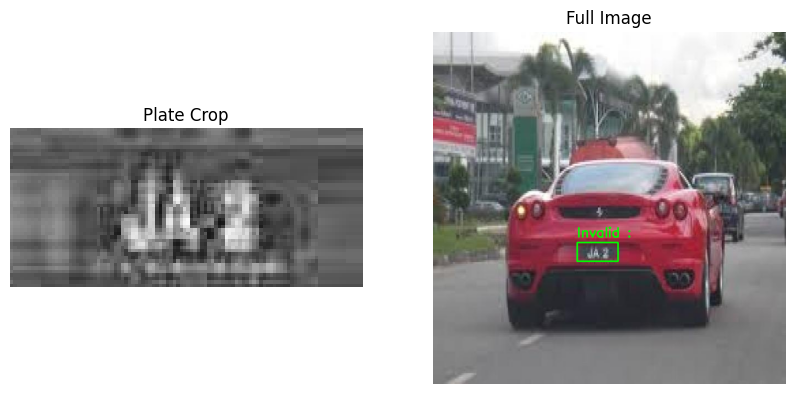


🔹 Processing: gray_carplate33_jpg.rf.589ef842108540adc0f9b64a53323dc3.jpg
➡️ Plate: WWV8993 (conf=0.99)


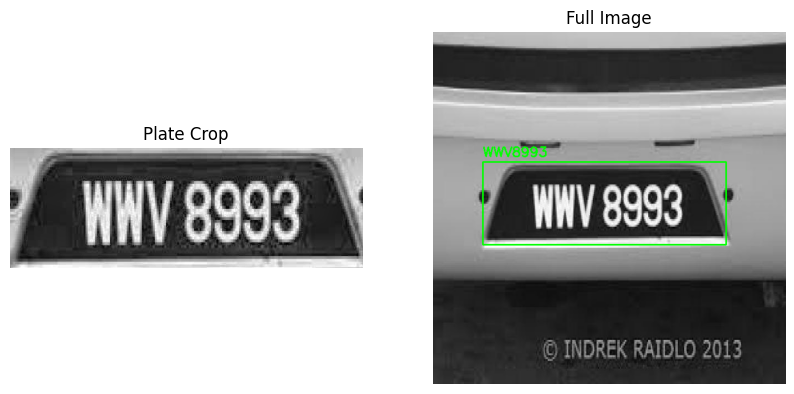


✅ OCR results with confidence saved to ocr_results_modelC.csv


In [ ]:
# Model C
results_list = []
detector = PlateDetection("./model/modelC/weights/best.pt")

for filename in os.listdir(test_path):
    if filename.lower().endswith(('.jpg', '.jpeg', '.png')):
        img_path = os.path.join(test_path, filename)
        print(f"\n🔹 Processing: {filename}")
        detector.detect_plate(img_path)

# Save all results to CSV
df = pd.DataFrame(results_list)
df.to_csv("ocr_results_modelC.csv", index=False)
print("\n✅ OCR results with confidence saved to ocr_results_modelC.csv")

- ## Model B (without padding)

Creating model: ('PP-LCNet_x1_0_doc_ori', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models/PP-LCNet_x1_0_doc_ori`.
Creating model: ('UVDoc', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models/UVDoc`.
Creating model: ('PP-LCNet_x1_0_textline_ori', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models/PP-LCNet_x1_0_textline_ori`.
Creating model: ('PP-OCRv5_server_det', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models/PP-OCRv5_server_det`.
Creating model: ('en_PP-OCRv5_mobile_rec', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/ting/.paddlex/official_models


🔹 Processing: gray_malaysia-car-plates_12_jpeg_jpg.rf.c5d4b85fb8dbd796d0563b7dedb72eac.jpg
➡️ Plate: A1 (conf=0.98)


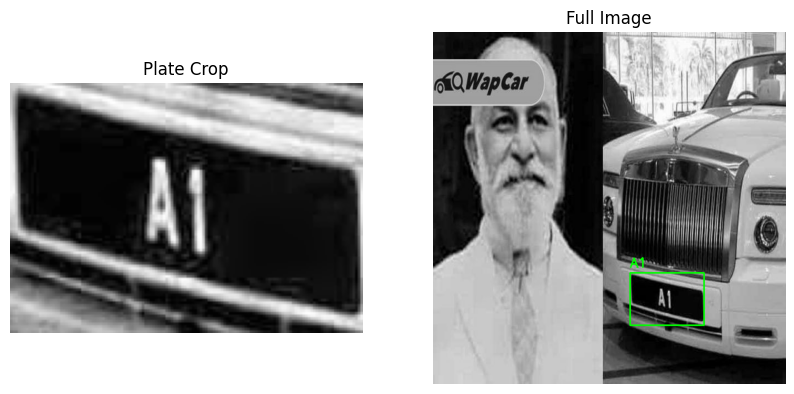


🔹 Processing: dst_nombor-plate-teksi-malaysia_258_jpeg_jpg.rf.0513319b4775cb2a43bb6c23cc5025a4.jpg
➡️ Plate: HQ1991 (conf=0.93)


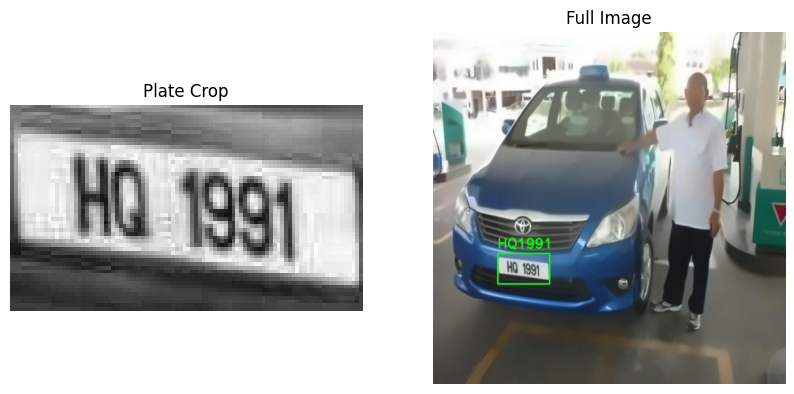


🔹 Processing: gray_nombor-plate-kerata-serawak-dan-sabah_31_png_jpg.rf.f8baf73e0e4d2683fdbd67eb7c75eb10.jpg
➡️ Plate: WBH2222 (conf=0.96)


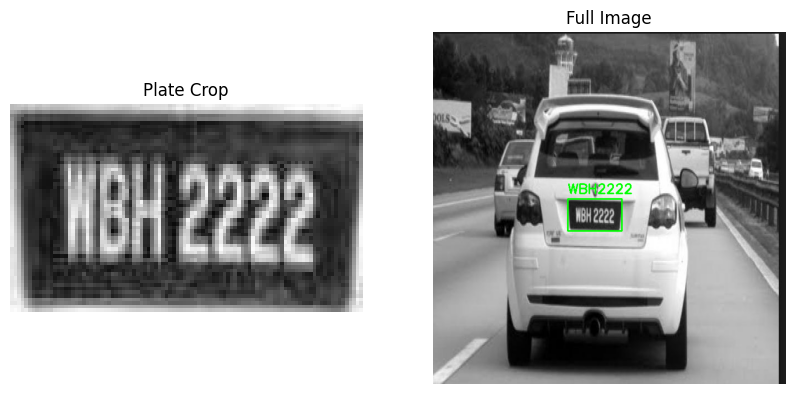


🔹 Processing: dst_carplate18_jpg.rf.c03ae99301bc7d434ec8f8d86f30d0ad.jpg
➡️ Plate: BMM4149 (conf=0.91)


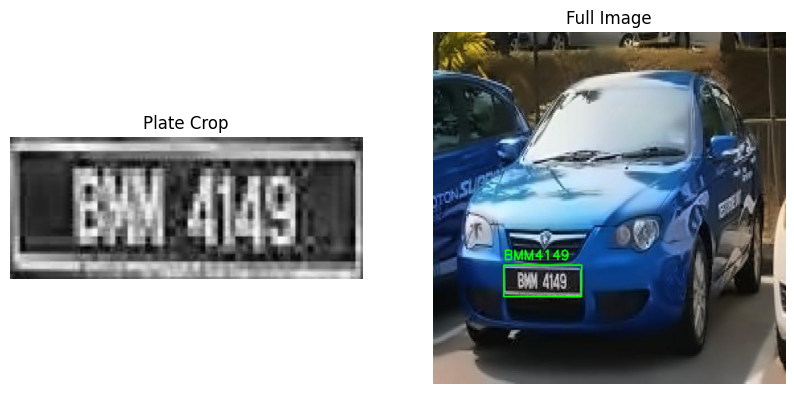


🔹 Processing: dst_nombor-plate-kerata-serawak-dan-sabah_255_jpeg_jpg.rf.584a9fef96b8384c960757bc58db6d73.jpg
➡️ Plate: HJA8888 (conf=0.85)


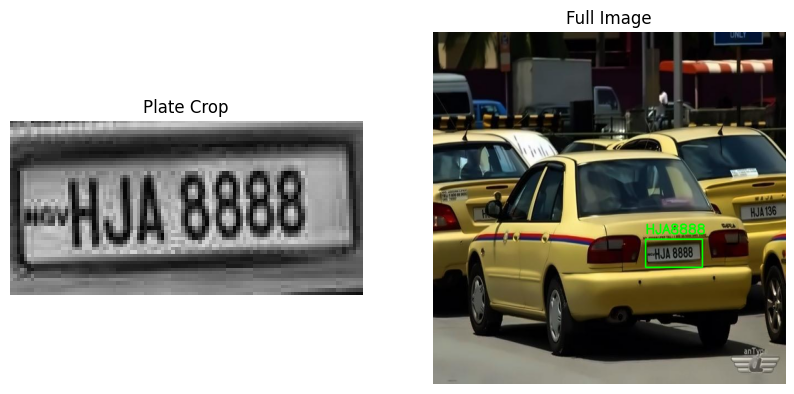

➡️ Plate: Invalid : QNL (conf=0.97)


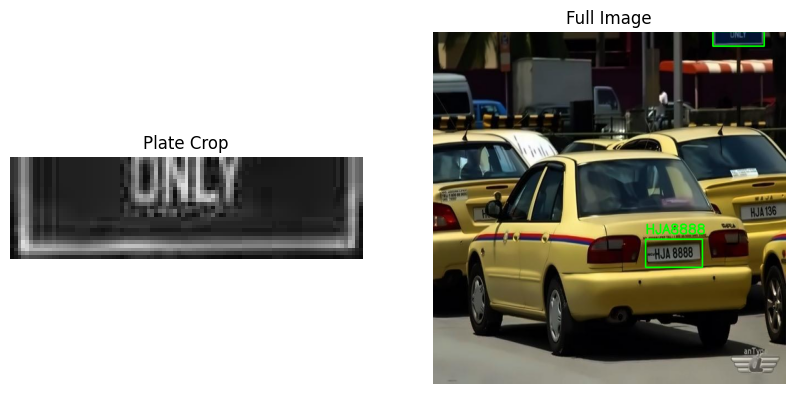

➡️ Plate: HJA136 (conf=1.00)


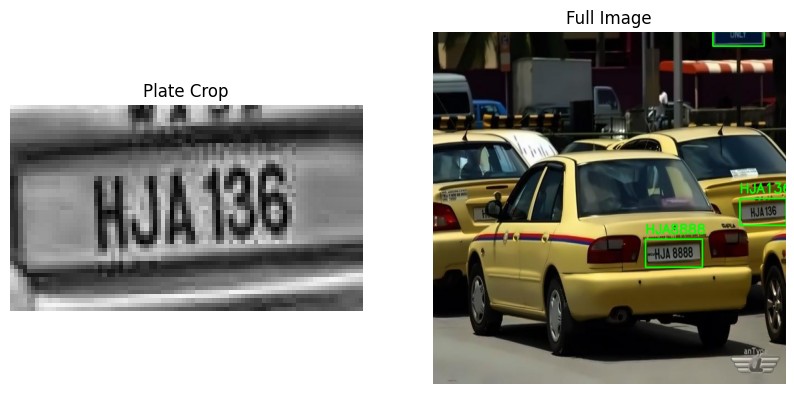

➡️ Plate: Invalid :  (conf=0.00)


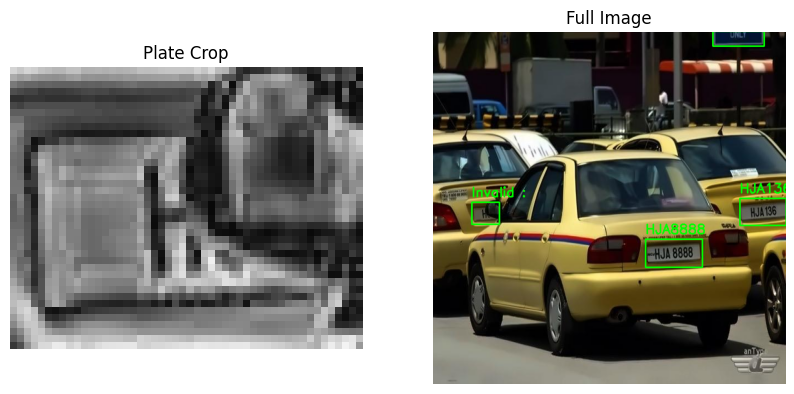


🔹 Processing: gray_malaysia-custom-car-plates_28_jpeg_jpg.rf.dabb73219f6c89d419f61ba45170cecd.jpg
➡️ Plate: PEN15 (conf=1.00)


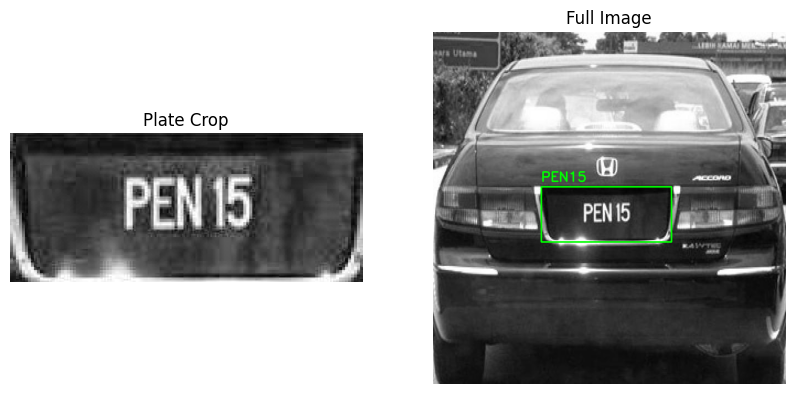


🔹 Processing: gray_carplate15_jpg.rf.df5c7a1ffb2932d2f738c4724d993030.jpg
➡️ Plate: Invalid : ZEZNN (conf=0.42)


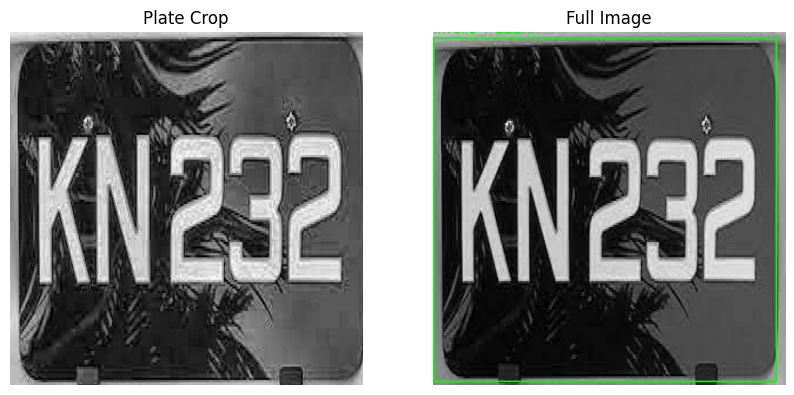


🔹 Processing: carplate49_jpg.rf.10e1c820dda8db5ec0967cf2e87abac5.jpg
➡️ Plate: Invalid : WNQ0QCE (conf=0.26)


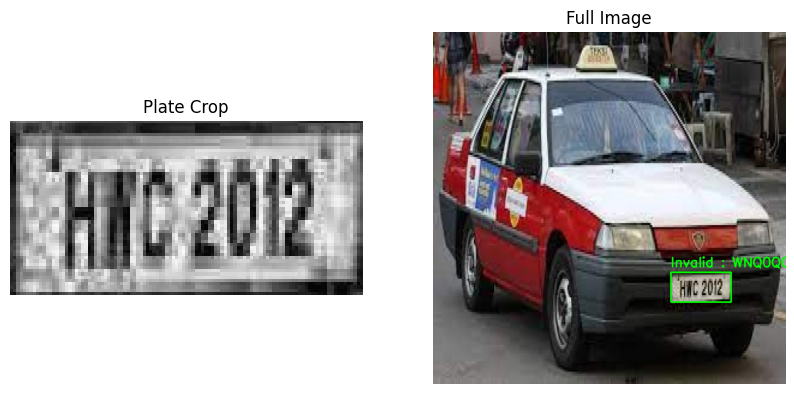


🔹 Processing: gray_malaysia-car-plate-number_12_jpeg_jpg.rf.f009ff3bdc1179a5396697a0d7b7447c.jpg
➡️ Plate: UTM9999 (conf=0.95)


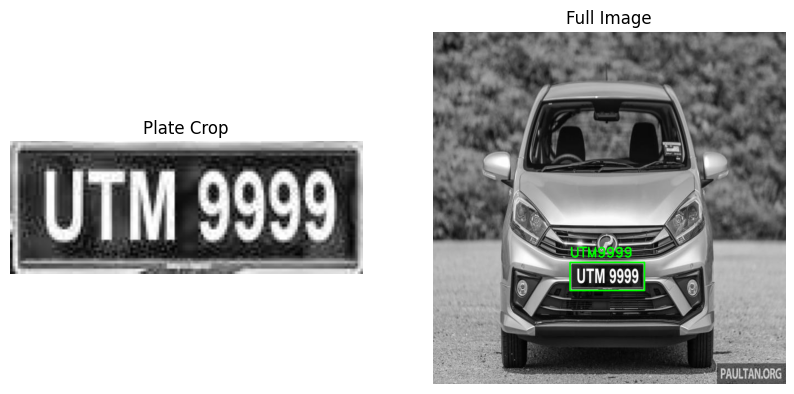


🔹 Processing: dst_carplate13_jpg.rf.ee22be89f78b37ab09e7714a0f6d11d7.jpg
➡️ Plate: Invalid :  (conf=0.00)


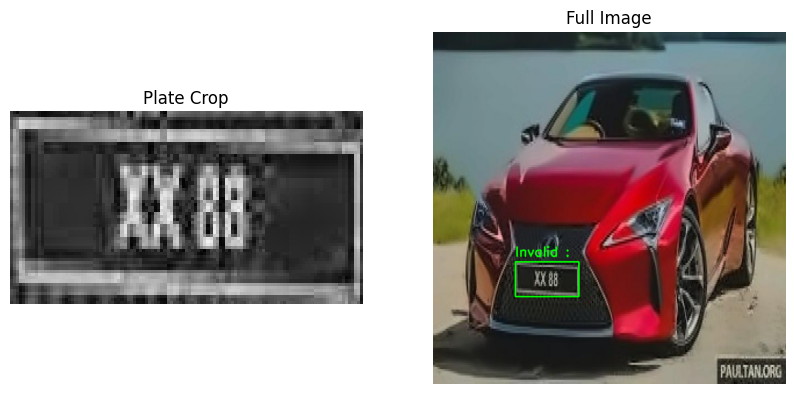


🔹 Processing: IMG_8054_jpg.rf.647b31d2b063f7405da74d7f9ead5426.jpg
➡️ Plate: AMY2831 (conf=1.00)


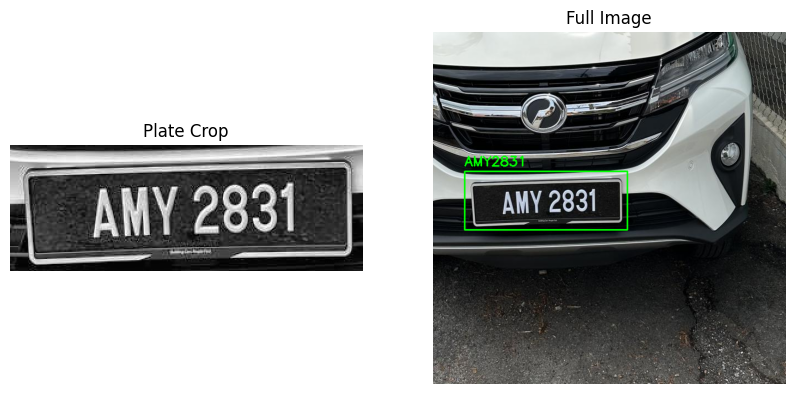


🔹 Processing: dst_carplate5_jpg.rf.3eaf43dec4c35612b8a6dc092215594a.jpg
➡️ Plate: JQK6888 (conf=0.95)


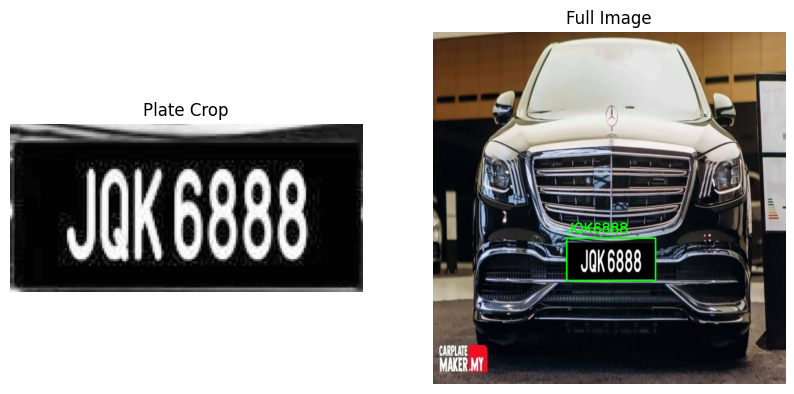


🔹 Processing: gray_malaysia-car-plate-number_13_jpeg_jpg.rf.959a3292d2ff2f4cd30ca6a5e07e435a.jpg
➡️ Plate: YA8055 (conf=1.00)


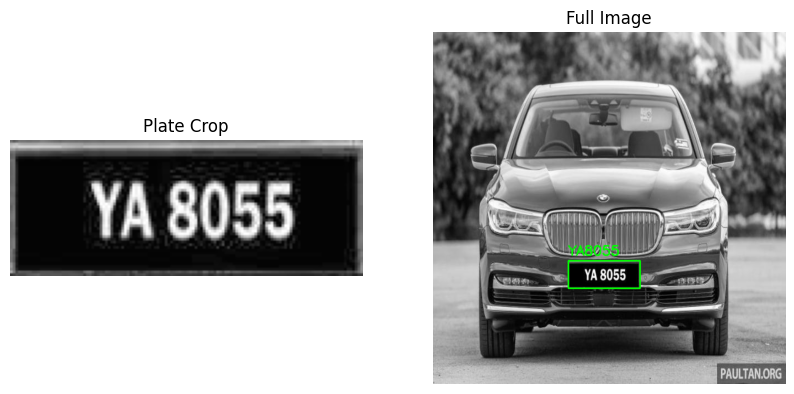


🔹 Processing: abbb718d-f9e1-45d9-9245-3f0c5b4249fb_jpg.rf.305cb37a21af84b698d7b4dc71a1887f.jpg
➡️ Plate: VCT9264 (conf=1.00)


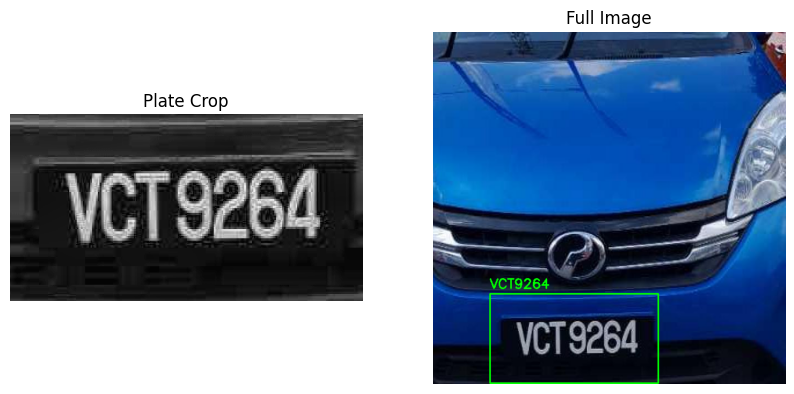


🔹 Processing: gray_malaysia-custom-car-plates_17_jpeg_jpg.rf.936859c6a1507c3f8892c69e5383fc34.jpg
➡️ Plate: Invalid : 1M (conf=1.00)


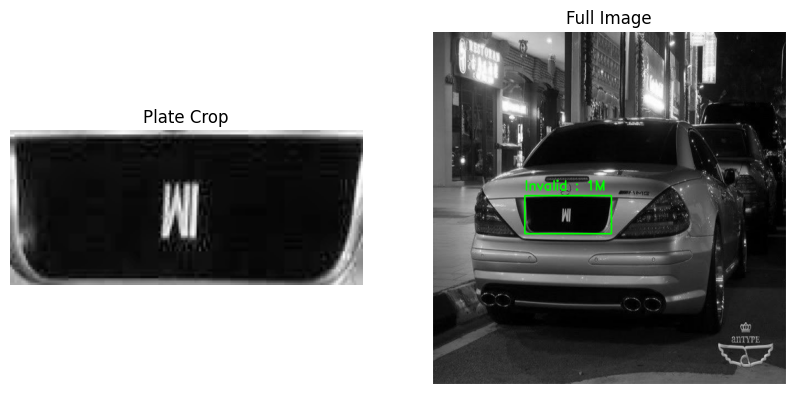


🔹 Processing: 3f7bbcb9-9c47-4950-8e53-012e36bb2acc-1-_jpg.rf.52ca16153522bb635ce255a04b51aa47.jpg
➡️ Plate: JRC5492 (conf=1.00)


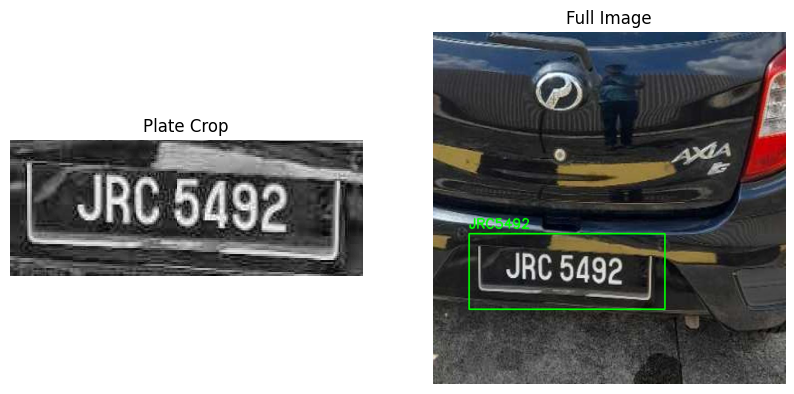


🔹 Processing: f787f1a2-82e4-4726-89cf-ca929c68eafe_jpg.rf.5eb37cd1e1a444aa606dd9946552e6f4.jpg
➡️ Plate: VL716 (conf=0.99)


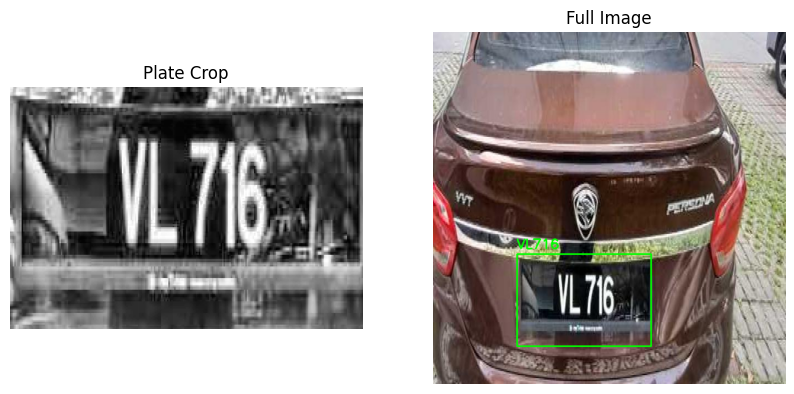


🔹 Processing: gray_carplate51_jpg.rf.244f1ad489185752fa5fa0656be77c27.jpg
➡️ Plate: W4575K (conf=1.00)


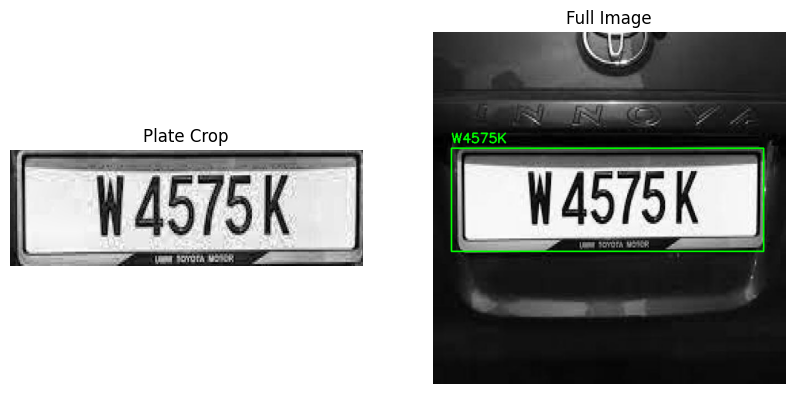


🔹 Processing: carplate38_jpg.rf.4cdb09a07b2ae8d05be66221a873fea2.jpg
➡️ Plate: Invalid :  (conf=0.00)


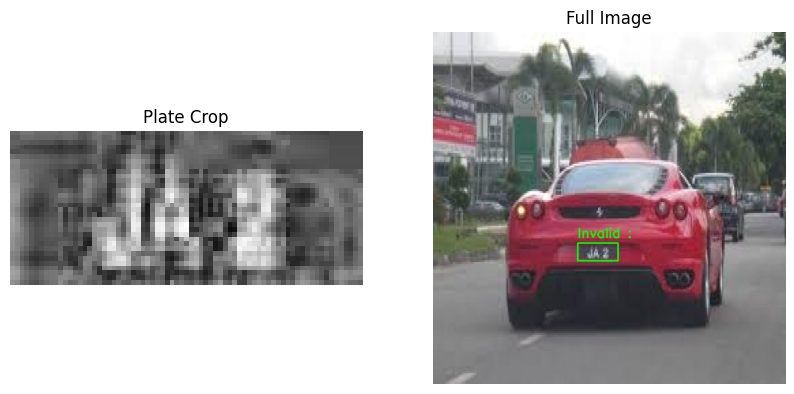


🔹 Processing: gray_carplate33_jpg.rf.589ef842108540adc0f9b64a53323dc3.jpg
➡️ Plate: WWV8993 (conf=0.93)


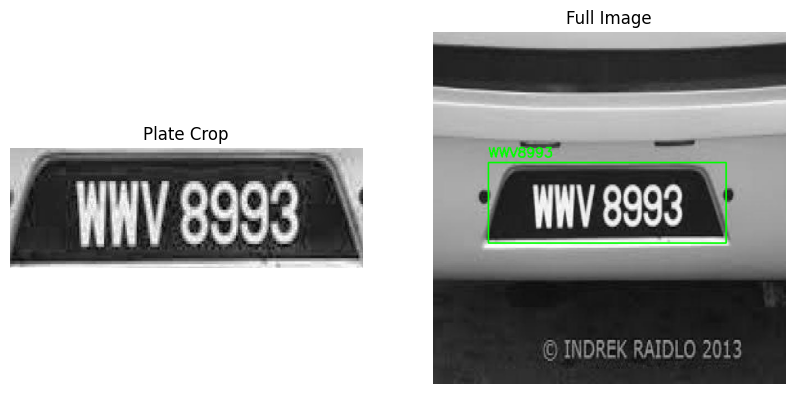


✅ OCR results with confidence saved to ocr_results_modelB_noPadding.csv


In [ ]:
# without padding (Model B)
results_list = []
detector = PlateDetection("./model/modelB/weights/best.pt")

for filename in os.listdir(test_path):
    if filename.lower().endswith(('.jpg', '.jpeg', '.png')):
        img_path = os.path.join(test_path, filename)
        print(f"\n🔹 Processing: {filename}")
        detector.detect_plate(img_path)

# Save all results to CSV
df = pd.DataFrame(results_list)
df.to_csv("ocr_results_modelB_noPadding.csv", index=False)
print("\n✅ OCR results with confidence saved to ocr_results_modelB_noPadding.csv")

# 6. Evaluation on Accuracy

In [ ]:
############################
# Coded by Chin Zi Wei, Look Zheng Hong
############################

from typing import Tuple, Dict
import pandas as pd
from sklearn.metrics import accuracy_score
import Levenshtein
import math
import os

def evaluate_ocr(
    ocr_csv_path: str,
    gt_csv_path: str,
    output_csv_path: str = "evaluation_results.csv",
) -> Tuple[Dict[str, float], pd.DataFrame]:
    """
    Evaluate OCR license plate predictions against ground truth.

    Parameters
    ----------
    ocr_csv_path : str
        Path to CSV with columns: ["filename", "predicted_plate"].
    gt_csv_path : str
        Path to CSV with columns: ["filename", "plate"].
    output_csv_path : str, optional
        Where to save the merged results with metrics per row.

    Returns
    -------
    metrics : dict
        {"exact_match_acc": float, "char_acc": float, "avg_edit_distance": float}
    merged : pd.DataFrame
        Merged dataframe with columns including:
        ["filename", "predicted_plate", "plate", "edit_distance", "exact_match"]
    """
    # --- Load
    ocr_df = pd.read_csv(ocr_csv_path)
    gt_df = pd.read_csv(gt_csv_path)

    # --- Basic column checks
    required_ocr_cols = {"filename", "predicted_plate"}
    required_gt_cols = {"filename", "plate"}
    if not required_ocr_cols.issubset(ocr_df.columns):
        missing = required_ocr_cols - set(ocr_df.columns)
        raise ValueError(f"OCR CSV missing columns: {missing}")
    if not required_gt_cols.issubset(gt_df.columns):
        missing = required_gt_cols - set(gt_df.columns)
        raise ValueError(f"Ground truth CSV missing columns: {missing}")

    # --- Merge on filename (inner join)
    merged = pd.merge(ocr_df, gt_df, on="filename", how="inner")
    if merged.empty:
        raise ValueError("No overlapping filenames between OCR and ground truth.")

    # --- Normalize text (remove spaces, uppercase)
    merged["predicted_plate"] = (
        merged["predicted_plate"].fillna("").str.replace(" ", "", regex=False).str.upper()
    )
    merged["plate"] = merged["plate"].fillna("").str.replace(" ", "", regex=False).str.upper()

    # --- Extract columns
    y_true = merged["plate"]
    y_pred = merged["predicted_plate"]

    # 1) Exact Match Accuracy
    exact_match_acc = accuracy_score(y_true, y_pred) if len(merged) > 0 else float("nan")

    # 2) Character-Level Accuracy (counts missing/extra as incorrect vs GT length)
    def char_level_accuracy(true_series: pd.Series, pred_series: pd.Series) -> float:
        total_chars, correct_chars = 0, 0
        for gt, pred in zip(true_series, pred_series):
            gt = gt or ""
            pred = pred or ""
            min_len = min(len(gt), len(pred))
            total_chars += len(gt)  # denominator is GT length
            correct_chars += sum(gt[i] == pred[i] for i in range(min_len))
            # implicit: extra GT chars unmatched => incorrect; extra pred chars ignored
        return (correct_chars / total_chars) if total_chars > 0 else float("nan")

    char_acc = char_level_accuracy(y_true, y_pred)

    # 3) Average Edit Distance (Levenshtein)
    edit_distances = [Levenshtein.distance(gt, pred) for gt, pred in zip(y_true, y_pred)]
    avg_edit_distance = (sum(edit_distances) / len(edit_distances)) if len(edit_distances) > 0 else float("nan")

    # --- Per-row results
    merged["edit_distance"] = edit_distances
    merged["exact_match"] = (merged["plate"] == merged["predicted_plate"]).astype(int)

    # --- Save
    merged.to_csv(output_csv_path, index=False)

    # --- Print summary (optional)
    print("📊 Evaluation Results :")
    print(f"Pairs evaluated      : {len(merged)}")
    print(f"Exact Match Accuracy : {exact_match_acc:.2f}" if not math.isnan(exact_match_acc) else "Exact Match Accuracy : NaN")
    print(f"Character-Level Acc. : {char_acc:.2f}" if not math.isnan(char_acc) else "Character-Level Acc. : NaN")
    print(f"Avg. Edit Distance   : {avg_edit_distance:.2f}" if not math.isnan(avg_edit_distance) else "Avg. Edit Distance   : NaN")
    print("\n")
    #print(f"\n✅ Detailed results saved to {os.path.abspath(output_csv_path)}")

    metrics = {
        "n_pairs": len(merged),
        "exact_match_acc": exact_match_acc,
        "char_acc": char_acc,
        "avg_edit_distance": avg_edit_distance,
    }
    return metrics, merged

In [61]:
# Evaluation Results for all Models
metrics, df = evaluate_ocr("ocr_results_modelA.csv", "ground_truth_testset.csv")
metrics, df = evaluate_ocr("ocr_results_modelB.csv", "ground_truth_testset.csv")
metrics, df = evaluate_ocr("ocr_results_modelC.csv", "ground_truth_testset.csv")

📊 Evaluation Results :
Pairs evaluated      : 21
Exact Match Accuracy : 0.62
Character-Level Acc. : 0.67
Avg. Edit Distance   : 3.48


📊 Evaluation Results :
Pairs evaluated      : 23
Exact Match Accuracy : 0.65
Character-Level Acc. : 0.72
Avg. Edit Distance   : 3.09


📊 Evaluation Results :
Pairs evaluated      : 24
Exact Match Accuracy : 0.58
Character-Level Acc. : 0.67
Avg. Edit Distance   : 3.12




/opt/homebrew/Caskroom/miniconda/base/envs/dlenv/lib/python3.11/site-packages/sklearn/metrics/_classification.py:98: UserWarning: The number of unique classes is greater than 50% of the number of samples. `y` could represent a regression problem, not a classification problem.
  type_true = type_of_target(y_true, input_name="y_true")
/opt/homebrew/Caskroom/miniconda/base/envs/dlenv/lib/python3.11/site-packages/sklearn/metrics/_classification.py:98: UserWarning: The number of unique classes is greater than 50% of the number of samples. `y` could represent a regression problem, not a classification problem.
  type_true = type_of_target(y_true, input_name="y_true")
/opt/homebrew/Caskroom/miniconda/base/envs/dlenv/lib/python3.11/site-packages/sklearn/metrics/_classification.py:99: UserWarning: The number of unique classes is greater than 50% of the number of samples. `y` could represent a regression problem, not a classification problem.
  type_pred = type_of_target(y_pred, input_name="y_pr

In [80]:
# Evaluation Results for Model B without padding
metrics, df = evaluate_ocr("ocr_results_modelB_noPadding.csv", "ground_truth_testset.csv")

📊 Evaluation Results :
Pairs evaluated      : 23
Exact Match Accuracy : 0.61
Character-Level Acc. : 0.71
Avg. Edit Distance   : 3.09




/opt/homebrew/Caskroom/miniconda/base/envs/dlenv/lib/python3.11/site-packages/sklearn/metrics/_classification.py:98: UserWarning: The number of unique classes is greater than 50% of the number of samples. `y` could represent a regression problem, not a classification problem.
  type_true = type_of_target(y_true, input_name="y_true")
/opt/homebrew/Caskroom/miniconda/base/envs/dlenv/lib/python3.11/site-packages/sklearn/metrics/_classification.py:99: UserWarning: The number of unique classes is greater than 50% of the number of samples. `y` could represent a regression problem, not a classification problem.
  type_pred = type_of_target(y_pred, input_name="y_pred")
